# Imports

In [2]:
from pandas import read_csv
from matplotlib import pyplot as plt
import sys
import numpy as np
import pandas as pd
from datetime import datetime

from sklearn.model_selection import train_test_split
from tensorflow import keras
from tensorflow.keras import layers
from keras.optimizers import Adam
from keras.layers import MaxPooling2D,Activation, Dense
from tensorflow import Tensor
from tensorflow.keras.layers import Input, Conv1D, Conv2D, ReLU, BatchNormalization,\
                                    Add, AveragePooling2D, Flatten, Dense,Dropout,LSTM,TimeDistributed,\
                                    MaxPooling1D,Flatten
from tensorflow.keras.models import Model
from keras.models import Sequential
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score

# Variáveis Globais

In [3]:
file_path = "C:\\Users\\lopes\\Desktop\\Apple watch\\Exercicio"

users1=["AntonioC","GusC","DarC"]

repetition=["R1","R2","R3","R4"]

pesos=["3kg","5kg"]

# Funções Definidas

In [4]:
def getMedian(vs):
    if (len(vs)==0):
        return 0
    return (np.median(vs))

In [5]:
def getMatrix(exer, file_path, users1,repetition, pesos):
        X = []
        Y = []
        CV_Pesos = []
        CV_Utilizadores = []
        CV_Repeticao = []
        tW=list(np.arange(-2.5,2.5+0.125,0.1))
        tStep=0.1
        for ixa,ps in enumerate(pesos):
                for ixu,us in enumerate(users1):             
                    for ixc,cl in enumerate(repetition):       
                        print("the user user is ",us," try nº ",cl," peso: ",ps)
                        data_input = pd.read_csv(file_path+exer+"\\"+us+exer+"_"+cl+"_"+ps+".txt", skiprows=1, header=None, sep='\s+',
                                                 names=["TimeStep","Dias","Segundos","XACC","YACC","ZACC","XGYR","YGYR","ZGYR"])
                        tMax_input= data_input["Segundos"].iloc[-1]
                        data_output = pd.read_excel(file_path+exer+"\\"+us+exer+"_"+cl+"_"+ps+".xlsx",header=0,sheet_name='Serie 1')
                        tMax_output = data_output["Tiempo (s)"].iloc[-1]
                        offset_scene = float(open(file_path+exer+"\\"+us+exer+"_"+cl+"_"+ps+".txt").readline().split('=')[1])
                        print("Offset Inicial = ",offset_scene)
                        
                        print("Tempo Input = ",tMax_input," Tempo Output = ",tMax_output)
                        tMaxMin=min(tMax_input,tMax_output)
         
                        for t in np.arange(0-min(tW),tMaxMin-max(tW),tStep): #len = 131
                            xi=[]
                            yi=[]
                               
                            xi1=[]
                            xi2=[]
                            xi3=[]
                            xi4=[]
                            xi5=[]
                            xi6=[]
                            Tempos = []
                            for it in range(0,len(tW)-2,1): #len = 50
                
                                    tr=t
                
                                    t0=tr+tW[it]
                                    tN=tr+tW[it+1]                                         
                                    ag1=data_input.iloc[np.where((data_input["Segundos"] >= t0+offset_scene ) & (data_input["Segundos"] <=  tN+offset_scene))]
                
                                    Tempos.append(t0)
                                    Tempos.append(tN)
                
                                    xi1.append(getMedian(ag1.iloc[:,3]))
                                    xi2.append(getMedian(ag1.iloc[:,4]))
                                    xi3.append(getMedian(ag1.iloc[:,5]))
                                    xi4.append(getMedian(ag1.iloc[:,6]))
                                    xi5.append(getMedian(ag1.iloc[:,7]))
                                    xi6.append(getMedian(ag1.iloc[:,8]))
                                    
                            ag2=data_output.iloc[np.where((data_output["Tiempo (s)"] >= Tempos[0]) & (data_output["Tiempo (s)"] <=  Tempos[1]))]
                            
                            xi.append(xi1)
                            xi.append(xi2)
                            xi.append(xi3)
                            xi.append(xi4)
                            xi.append(xi5)
                            xi.append(xi6)
                            yi.append(getMedian(ag2.iloc[:,5]))
                         
                            # list of len 6,51 --> [[ACCX],[ACCY],[ACCZ],[GYRX],[GYRY],[GYRZ]]
                            X.append(np.transpose(xi))
                            Y.append(np.transpose(yi))
                            CV_Pesos.append(ixa)
                            CV_Utilizadores.append(ixu)
                            CV_Repeticao.append(ixc)
        
                        print("----------------------------------")
                                                    #                            it = 49              """             it = 0
        X=np.array(X)                               #matrix t=1   [[ACCX,ACCY,ACCZ,GYRX,GYRX,GYRX],          , [ACCX,ACCY,ACCZ,GYRX,GYRX,GYRX]]
        Y=np.array(Y)                               #       """
        CV_Pesos = np.array(CV_Pesos)               #       t=max [[ACCX,ACCY,ACCZ,GYRX,GYRX,GYRX],          , [ACCX,ACCY,ACCZ,GYRX,GYRX,GYRX]]
        CV_Utilizadores = np.array(CV_Utilizadores) 
        CV_Repeticao = np.array(CV_Repeticao) 
        
        print(X.shape,Y.shape,CV_Pesos.shape,CV_Utilizadores.shape,CV_Repeticao.shape)
    
        return X,Y,CV_Pesos,CV_Utilizadores,CV_Repeticao

In [6]:
def ResultadosRegressao(X,Y,S):
        for ixs,sc in enumerate(np.unique(S)):
            
            train_index=np.where(S != sc)[0]
            test_index=np.where(S == sc)[0]
        
            np.random.shuffle(train_index)
            
            print("SCENE", sc, " TRAIN:", train_index, " TEST:", test_index)
            x_train, x_val = np.copy(X[train_index]), np.copy(X[test_index])
            y_train, y_val = np.copy(Y[train_index]), np.copy(Y[test_index])
        
            #min_v=min(x_train[:,:,0].flatten())
            for ixv in range(0,X.shape[2]):
                min_v=min(x_train[:,:,ixv].flatten())
                max_v=max(x_train[:,:,ixv].flatten())
                print("min_v,max_v:",min_v,max_v,x_train[:,:,ixv])
                x_train[:,:,ixv]=(x_train[:,:,ixv]-min_v)/(max_v-min_v)
                
                print("normal",x_train[:,:,ixv])
            
                x_val[:,:,ixv]=(x_val[:,:,ixv]-min_v)/(max_v-min_v)
            
            min_v=min(y_train)
            max_v=max(y_train)
            print(y_train,min_v,max_v)
            y_train=(y_train-min_v)/(max_v-min_v)
            print("y normal",y_train)
            y_val=(y_val-min_v)/(max_v-min_v)
            
            model = Sequential([
                Input(shape=(X.shape[1], X.shape[2])),  # Explicit Input layer
                Conv1D(filters=16, kernel_size=2, activation='relu'),
                Conv1D(filters=32, kernel_size=3, activation='relu'),
                Dropout(0.25),
                Conv1D(filters=64, kernel_size=3, activation='relu'),
                Conv1D(filters=128, kernel_size=3, activation='relu'),
                Dropout(0.25),
                LSTM(256, return_sequences=True),
                Dropout(0.25),
                LSTM(256),
                Flatten(),
                Dense(2048, activation='relu'),
                Dense(1024, activation='relu'),
                Dense(1, activation="sigmoid") 
            ])
            
            model.compile(optimizer='adam', loss='mae')
            
            history = model.fit(x_train, y_train, batch_size=16, epochs=16, validation_data=(x_val, y_val)) #mudar epochs para 30
            
            y_pred = model.predict(x_val)
            y_pred=y_pred*(max_v-min_v)+min_v
            y_val=y_val*(max_v-min_v)+min_v
            
            print(y_pred)
            print(y_val)
            
            mse = mean_squared_error(y_val, y_pred)
            mae = mean_absolute_error(y_val, y_pred)
            rmse = np.sqrt(mse)
            r2 = r2_score(y_val, y_pred)
            
            print("Evaluation Metrics for Regression Model:")
            print(f"Mean Squared Error (MSE): {mse}")
            print(f"Mean Absolute Error (MAE): {mae}")
            print(f"Root Mean Squared Error (RMSE): {rmse}")
            print(f"R-squared: {r2}")
        
            indices = range(1, len(y_pred) + 1)
            
            plt.figure(figsize=(10, 10))  
            plt.plot(indices, y_pred, '-', label='Predicted')
            plt.plot(indices, y_val, '--', label='Actual')
            plt.xlabel('Index')
            plt.ylabel('Values')
            plt.title('Predicted vs. Actual')
            plt.grid(True, which='both', axis='x')
            plt.legend()
            plt.show()


# Exercicio 1 Matrix

In [7]:
exer="1"
Resultados1Matrix = getMatrix(exer, file_path, users1,repetition, pesos)

the user user is  AntonioC  try nº  R1  peso:  3kg
Offset Inicial =  1.4000000000000012
Tempo Input =  37.525  Tempo Output =  34.684
----------------------------------
the user user is  AntonioC  try nº  R2  peso:  3kg
Offset Inicial =  1.7000000000000015
Tempo Input =  37.574  Tempo Output =  34.312
----------------------------------
the user user is  AntonioC  try nº  R3  peso:  3kg
Offset Inicial =  1.4000000000000012
Tempo Input =  36.143  Tempo Output =  33.261
----------------------------------
the user user is  AntonioC  try nº  R4  peso:  3kg
Offset Inicial =  1.3000000000000012
Tempo Input =  37.149  Tempo Output =  34.192
----------------------------------
the user user is  GusC  try nº  R1  peso:  3kg
Offset Inicial =  0.8000000000000007
Tempo Input =  28.364  Tempo Output =  25.972
----------------------------------
the user user is  GusC  try nº  R2  peso:  3kg
Offset Inicial =  0.9000000000000008
Tempo Input =  28.011  Tempo Output =  26.109
-----------------------------

# Exercicio 1 Cross Validation Pesos

SCENE 0  TRAIN: [4475 4996 2814 ... 2843 4290 5235]  TEST: [   0    1    2 ... 2665 2666 2667]
min_v,max_v: -2.737507343 17.3195848465 [[10.80153847 10.13332844  8.82684469 ... -0.1700464  -0.37601808
  -0.50534916]
 [ 6.72880769  5.70852947  7.19942903 ...  5.30736351  3.48595107
   1.54598515]
 [-1.20349735 -1.43701184 -1.80344975 ... -1.09931397 -1.34839606
  -1.52083743]
 ...
 [ 0.91010743  2.66685438  7.3551054  ... -1.21187997 -0.94723025
   0.35685793]
 [ 8.00176048  9.99561405 10.78956318 ...  0.36045046 -1.14002931
  -1.40946907]
 [ 6.43781281  7.58263207  9.7165947  ...  9.80281496  7.77183866
   4.45952654]]
normal [[0.67502536 0.64170996 0.57657171 ... 0.12800764 0.11773837 0.11129022]
 [0.47196847 0.42109977 0.49543255 ... 0.40109856 0.31028717 0.21356498]
 [0.07648217 0.06483968 0.04656994 ... 0.08167651 0.06925786 0.06066033]
 ...
 [0.1818616  0.26944891 0.50319421 ... 0.07606424 0.08925905 0.15427786]
 [0.53543493 0.63484384 0.6744283  ... 0.15445698 0.07964654 0.066212

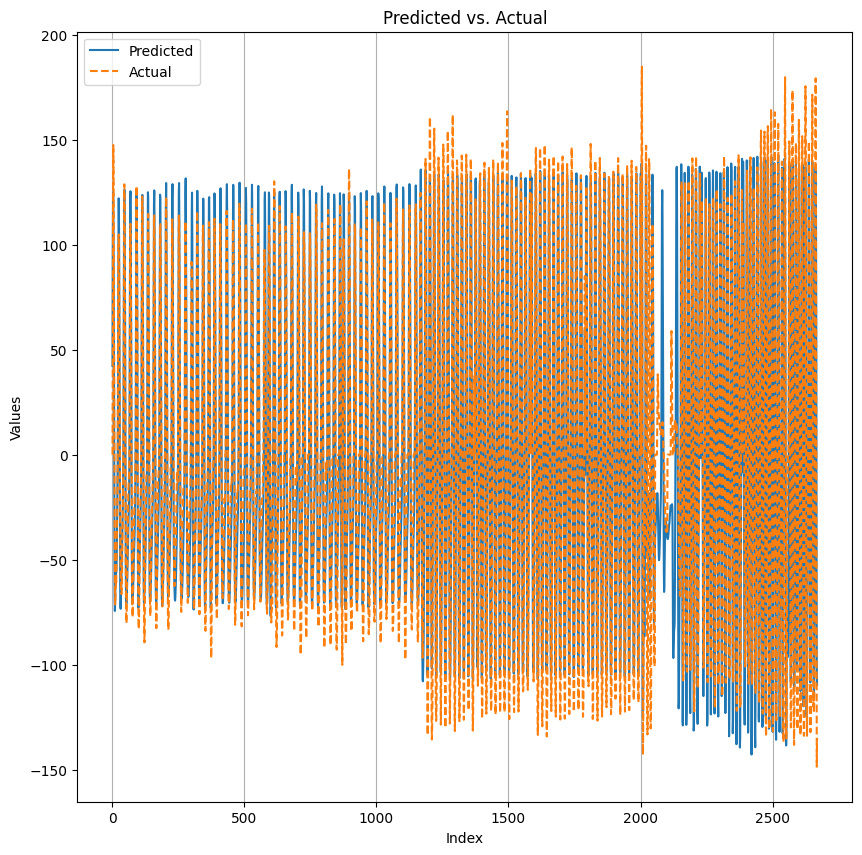

SCENE 1  TRAIN: [ 188 1736  412 ... 2637 1255 1330]  TEST: [2668 2669 2670 ... 5280 5281 5282]
min_v,max_v: -2.7291247844999997 14.942527771 [[ 6.92160678  5.50375509  3.93741238 ...  4.55772257  3.57217181
   2.83809829]
 [ 1.51125735  3.98291779  7.91673756 ...  4.19367933  2.48842537
   0.23950197]
 [ 7.38863563  6.60426664  7.3551054  ...  7.68202543  7.26409459
   7.1658988 ]
 ...
 [10.34408999  9.75012493  7.11799836 ...  1.404679    4.78764439
   9.55852366]
 [12.02180099  9.29746628  7.99337792 ...  0.84184939  2.49920297
   5.15887213]
 [11.48651409  7.6161623   5.29179573 ...  8.82804203  8.78852463
  10.51892662]]
normal [[0.5461137  0.46588059 0.37724469 ... 0.41234669 0.35657653 0.31503692]
 [0.23995391 0.37981975 0.60242596 ... 0.39174628 0.2952497  0.16798807]
 [0.57254184 0.52815612 0.57064443 ... 0.58914412 0.56549433 0.55993765]
 ...
 [0.73978451 0.70617333 0.55722707 ... 0.23392288 0.42535746 0.69533103]
 [0.83472249 0.68055837 0.60676287 ... 0.20207358 0.29585958 0.

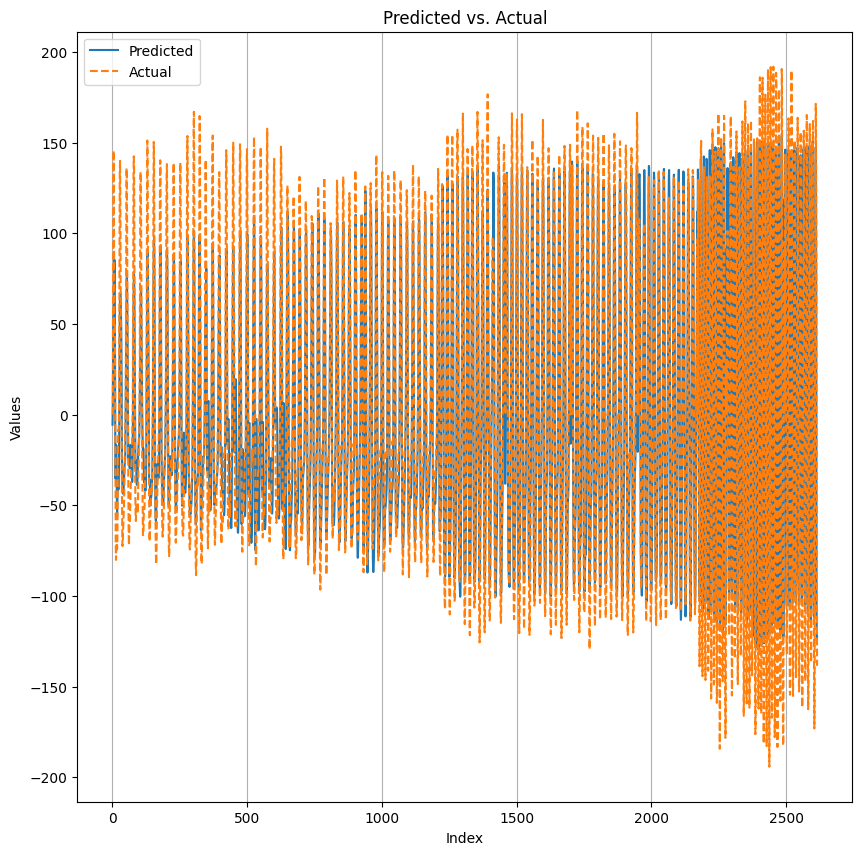

In [7]:
ResultadosRegressao(Resultados1Matrix[0],Resultados1Matrix[1],Resultados1Matrix[2])

# Exercicio 1 Cross Validation Utilizadores

SCENE 0  TRAIN: [4885 4507 4627 ... 4188 1316 1185]  TEST: [   0    1    2 ... 3884 3885 3886]
min_v,max_v: -2.737507343 17.3195848465 [[ 8.15863466  5.06187415  5.54686546 ...  7.74788833  3.03089726
  -0.82628179]
 [-0.3161426   3.38895273  8.50710964 ...  6.50726843  8.62087297
   9.49146271]
 [ 7.35271025  8.55980015  9.95849133 ... -0.05508545  1.73159921
   5.80313253]
 ...
 [11.4960947   8.78493214  5.54806304 ...  3.94938731  1.56035531
   0.44188112]
 [ 1.69926643  0.0239502   0.14370118 ... 11.69488096 10.34169483
   8.24964523]
 [ 8.21132469 11.92959309 11.89725971 ...  1.15200442  2.40100718
   5.50615025]]
normal [[0.54325632 0.38885903 0.41303957 ... 0.52277746 0.28759925 0.09528926]
 [0.12072362 0.30545106 0.56063047 ... 0.46092303 0.56630244 0.60970802]
 [0.5030748  0.56325749 0.63299299 ... 0.13373932 0.22281927 0.42581645]
 ...
 [0.70965432 0.57448205 0.41309928 ... 0.33339303 0.21428144 0.15851692]
 [0.22120723 0.13767985 0.14365036 ... 0.71956534 0.65209862 0.547793

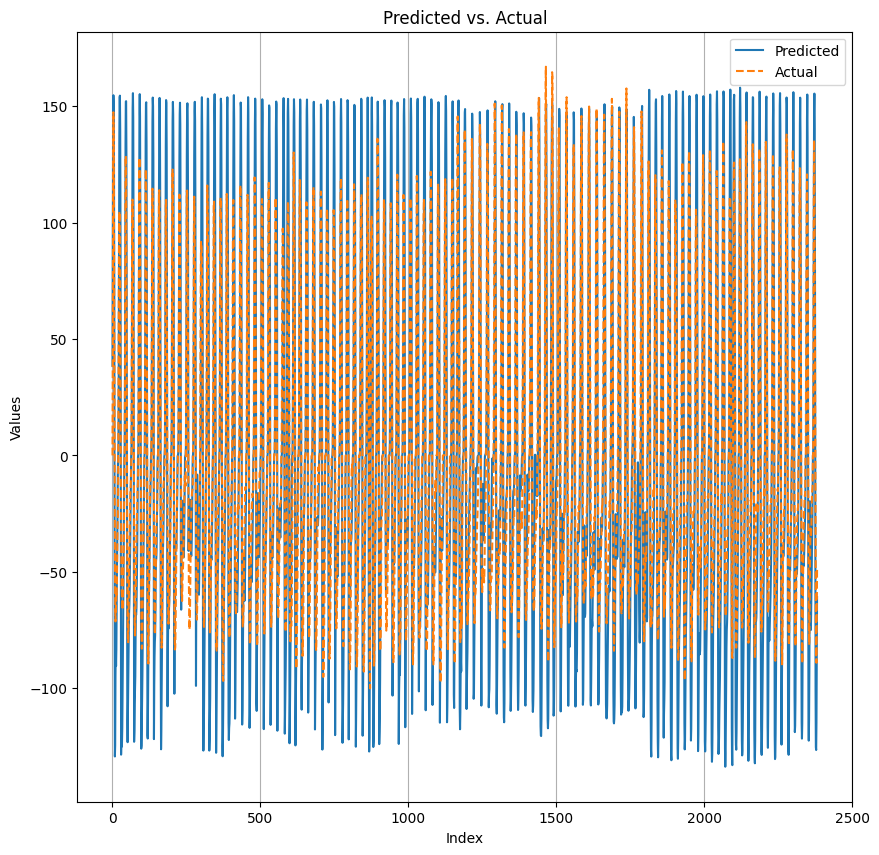

SCENE 1  TRAIN: [3829 3796 2644 ...   26  513 2316]  TEST: [1162 1163 1164 ... 4835 4836 4837]
min_v,max_v: -2.7291247844999997 17.3195848465 [[ 8.02810574  9.77527237  7.69040823 ...  7.02219772  8.49273968
   9.75371742]
 [ 0.75203618  0.09101075 -0.49816409 ... -0.64665532 -0.93286014
  -1.29810059]
 [ 3.66677511  2.40699482 -0.33530276 ...  9.04718637  9.34057617
   5.24509311]
 ...
 [ 8.09756136  7.70956802  6.47373819 ...  7.22816944  8.37777901
   7.58742213]
 [ 6.61025405  4.99601102  3.94938731 ...  4.64154816  3.37458277
   3.21411633]
 [ 8.35981607  8.35143375  7.36588287 ...  7.53712702  6.28932142
   3.25004172]]
normal [[0.53655476 0.62370085 0.5197109  ... 0.48638155 0.55973001 0.62262572]
 [0.17363516 0.14066419 0.11127702 ... 0.1038705  0.08959503 0.07137737]
 [0.31901803 0.25618205 0.1194003  ... 0.58738499 0.60201884 0.3977422 ]
 ...
 [0.5400191  0.52066657 0.4590252  ... 0.49665512 0.55399594 0.51457411]
 [0.46583441 0.38531835 0.33311431 ... 0.36763827 0.30444391 0

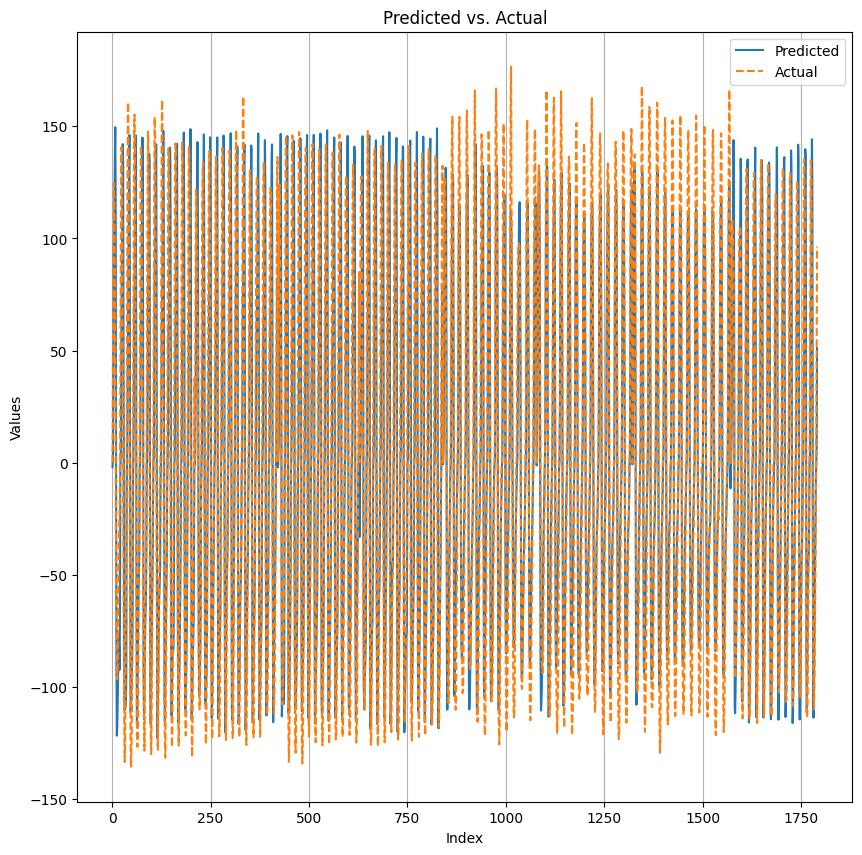

SCENE 2  TRAIN: [1186  704 2706 ... 3508 2981  623]  TEST: [2001 2002 2003 ... 5280 5281 5282]
min_v,max_v: -2.737507343 15.065871239 [[11.92959309 11.89725971 11.19671726 ...  2.40100718  5.50615025
  10.85662365]
 [ 4.89422274  6.59348917  7.76824617 ...  6.92519927  6.59109402
   7.16589856]
 [ 6.19112587  5.08941674  4.02123785 ...  6.36835718  6.88927412
   6.30129671]
 ...
 [ 8.3969388   7.07967806  5.62590098 ...  6.11927509  5.26664829
   3.12669814]
 [ 2.04534674  0.54007694 -0.17004639 ...  3.16142583  2.14713514
   1.11368418]
 [ 2.61296642  0.77598637  0.68737066 ... -0.78077638 -1.23104012
  -1.46096194]]
normal [[0.82383804 0.8220219  0.78267305 ... 0.28862581 0.46303894 0.76357029]
 [0.42866752 0.52411381 0.59009887 ... 0.54274567 0.52397927 0.55626553]
 [0.50151342 0.43963139 0.37963273 ... 0.51146834 0.54072778 0.50770161]
 ...
 [0.62541197 0.55142261 0.46976524 ... 0.49747762 0.44958633 0.32938723]
 [0.26864868 0.18409901 0.14421201 ... 0.33133785 0.27436604 0.2163180

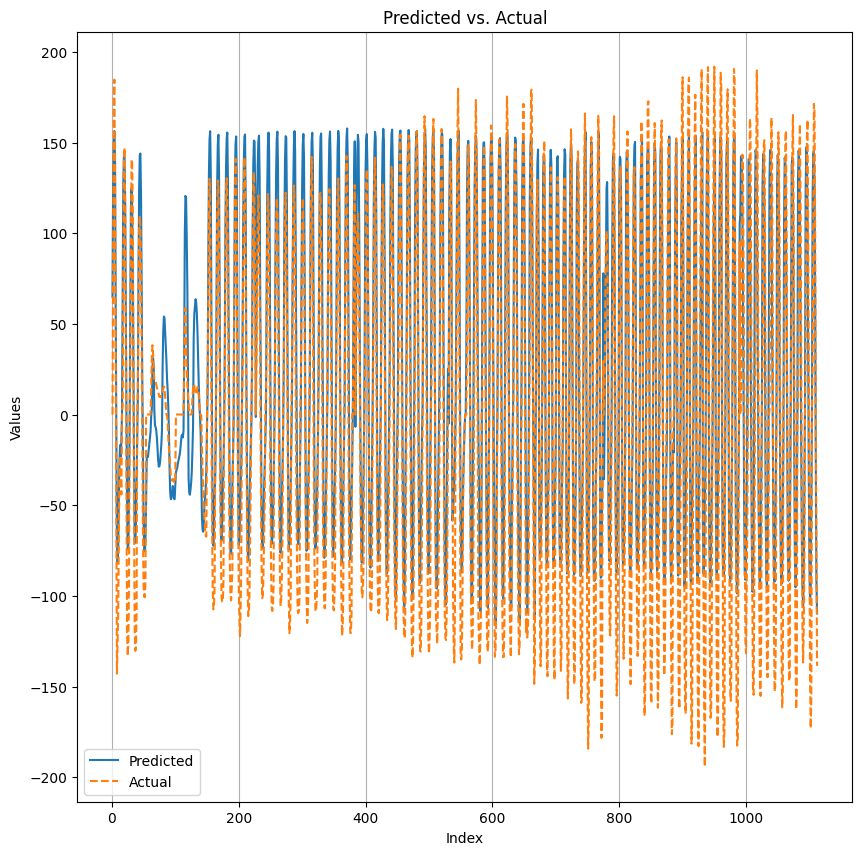

In [8]:
ResultadosRegressao(Resultados1Matrix[0],Resultados1Matrix[1],Resultados1Matrix[3])

# Exercicio 1 Cross Validation Repeticoes

SCENE 0  TRAIN: [ 417  772 4388 ... 3233 2661  954]  TEST: [   0    1    2 ... 4943 4944 4945]
min_v,max_v: -2.737507343 17.3195848465 [[ 5.47980499e+00  4.29427004e+00  3.34464490e+00 ...  7.64729762e+00
   6.07855987e+00  3.89789450e+00]
 [ 6.20429826e+00  7.98020554e+00  8.40172863e+00 ...  8.51908445e+00
   7.83889914e+00  7.67963028e+00]
 [-7.65208781e-01  2.56267108e-01  1.88009036e+00 ...  9.72976685e+00
   1.17236214e+01  1.13715534e+01]
 ...
 [-4.79003900e-03 -6.45457775e-01 -9.44835216e-01 ...  2.92072642e+00
   2.42136478e+00  1.49449223e+00]
 [ 6.16717577e+00  1.09919424e+01  1.07129231e+01 ...  1.69327885e+00
   3.72425556e+00  9.03880405e+00]
 [-1.00111818e+00 -7.85566449e-01 -9.38847721e-01 ... -1.38911134e+00
  -9.05317426e-01 -7.86763936e-01]]
normal [[0.40969609 0.35058808 0.30324197 ... 0.51776224 0.43954862 0.33082571]
 [0.44581764 0.53436025 0.55537642 ... 0.5612275  0.52731505 0.51937427]
 [0.09833422 0.14926264 0.23022269 ... 0.62158931 0.72099827 0.70344498]
 ..

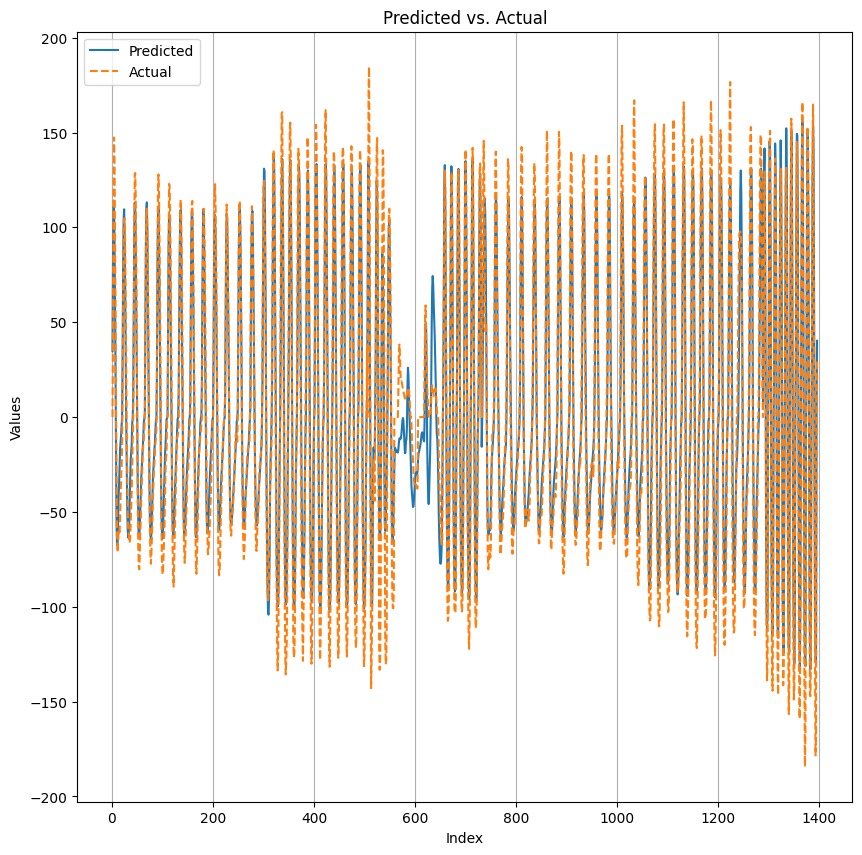

SCENE 1  TRAIN: [3375 2113 3993 ... 4745 3377  168]  TEST: [ 296  297  298 ... 5053 5054 5055]
min_v,max_v: -2.737507343 17.3195848465 [[ 0.99393314  0.75562871  0.55803955 ...  0.61072999 -0.22513184
  -0.51013917]
 [ 0.07185059  0.05987549  1.23104012 ...  6.20789099  4.60322761
   2.06929708]
 [ 9.32141638  7.38863563  3.93621469 ...  4.51700687  8.80289459
  10.70573807]
 ...
 [ 0.15926881 -0.39517823  0.80831914 ...  9.64713955 11.01708984
   8.86636257]
 [ 0.55803955  0.10298584 -0.43349856 ... -0.51013917 -0.55803955
  -0.16765138]
 [ 2.40938973  1.45497441  1.24301517 ...  0.55564457  0.42152345
  -0.38559815]]
normal [[0.18604095 0.17415964 0.16430831 ... 0.16693533 0.1252612  0.1110514 ]
 [0.14006806 0.13947101 0.19786255 ... 0.44599677 0.36599198 0.2396561 ]
 [0.60122991 0.50486595 0.33273627 ... 0.36169322 0.57537762 0.67024897]
 ...
 [0.14442653 0.11678309 0.17678667 ... 0.61746971 0.68577225 0.57854198]
 [0.16430831 0.14162039 0.11487252 ... 0.1110514  0.1086632  0.128127

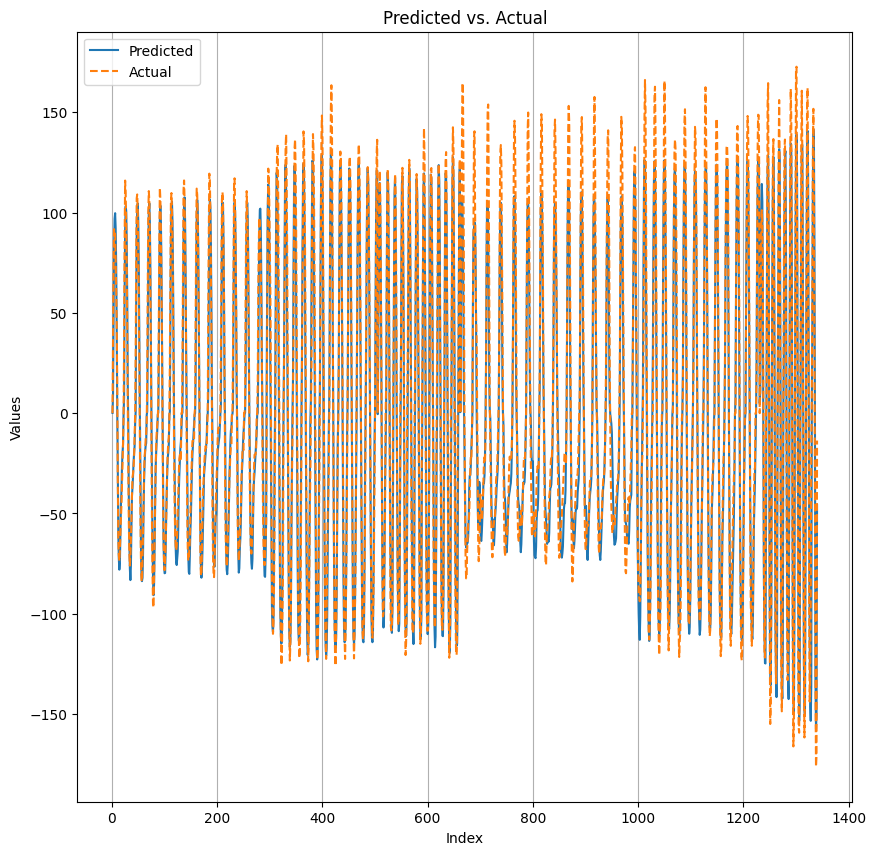

SCENE 2  TRAIN: [  96 2967 5000 ... 4662 1564 3275]  TEST: [ 589  590  591 ... 5158 5159 5160]
min_v,max_v: -2.737507343 17.199833869499997 [[ 7.34313035  7.95386004  7.63891506 ...  4.62957287  3.50151873
   2.56746101]
 [-0.96519291  3.08837771  6.63899422 ... -0.67060551  0.62629764
   1.6405884 ]
 [ 5.64985132  3.7086879   4.45473671 ...  4.13140869  6.72282028
   9.39446449]
 ...
 [ 7.92032981  8.95976829 11.09492827 ... -0.46463381 -0.39398072
   1.10889411]
 [11.89965534 10.1668582  10.28181887 ...  0.11136842 -0.05029541
   1.59029305]
 [ 6.40667772  6.04742455  5.19958782 ...  5.69176412  7.79339385
   8.64362621]]
normal [[0.50561595 0.5362484  0.52045166 ... 0.36951167 0.3129317  0.26608204]
 [0.08889422 0.29220973 0.47029849 ... 0.10366988 0.16871883 0.21959276]
 [0.42068592 0.32332271 0.36074239 ... 0.34452518 0.47450297 0.608505  ]
 ...
 [0.53456662 0.58670188 0.6937954  ... 0.11400083 0.11754459 0.19292449]
 [0.73415821 0.64724606 0.65301216 ... 0.14289146 0.13478286 0.2

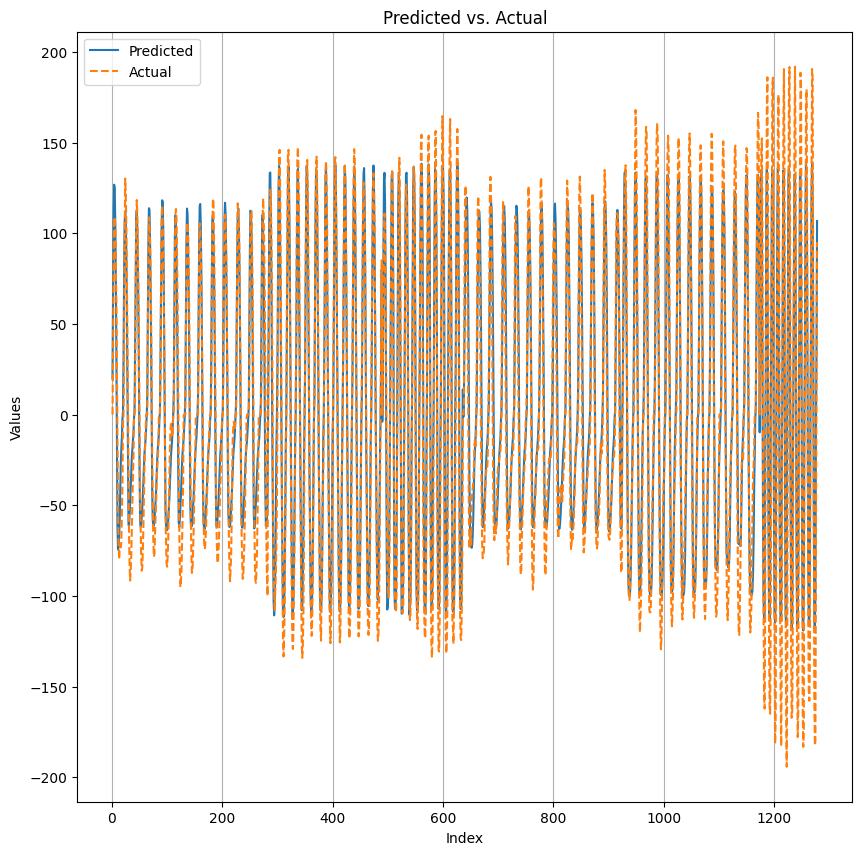

SCENE 3  TRAIN: [4513 3503  824 ... 4996 3192 2840]  TEST: [ 871  872  873 ... 5280 5281 5282]
min_v,max_v: -2.7291247844999997 17.3195848465 [[ 6.6030693   8.49513435 10.14650059 ...  4.36612082  2.792593
   1.07536382]
 [ 9.41242695  9.41601944  7.23774934 ...  7.8053689   5.27622843
   8.78014231]
 [ 7.25211954  5.7456522   4.40324354 ...  2.61416399  1.96870613
   0.90052736]
 ...
 [ 6.72880769  5.70852947  7.19942903 ...  5.30736351  3.48595107
   1.54598515]
 [ 5.91569853 10.97397995 10.07704496 ...  0.57719973  2.6417067
   6.91921186]
 [-1.65256351 -0.73766607 -0.1592688  ... -1.48970223 -1.71124148
  -1.57233036]]
normal [[0.46547605 0.55984945 0.64221716 ... 0.35390036 0.27541512 0.18976227]
 [0.60560265 0.60578184 0.49713295 ... 0.52544497 0.39929518 0.57406523]
 [0.49784971 0.42270935 0.35575199 ... 0.26651535 0.23432086 0.18104168]
 ...
 [0.47174769 0.42085772 0.49522159 ... 0.40084816 0.3099988  0.21323616]
 [0.43119101 0.68349061 0.63875282 ... 0.16491458 0.26788914 0.48

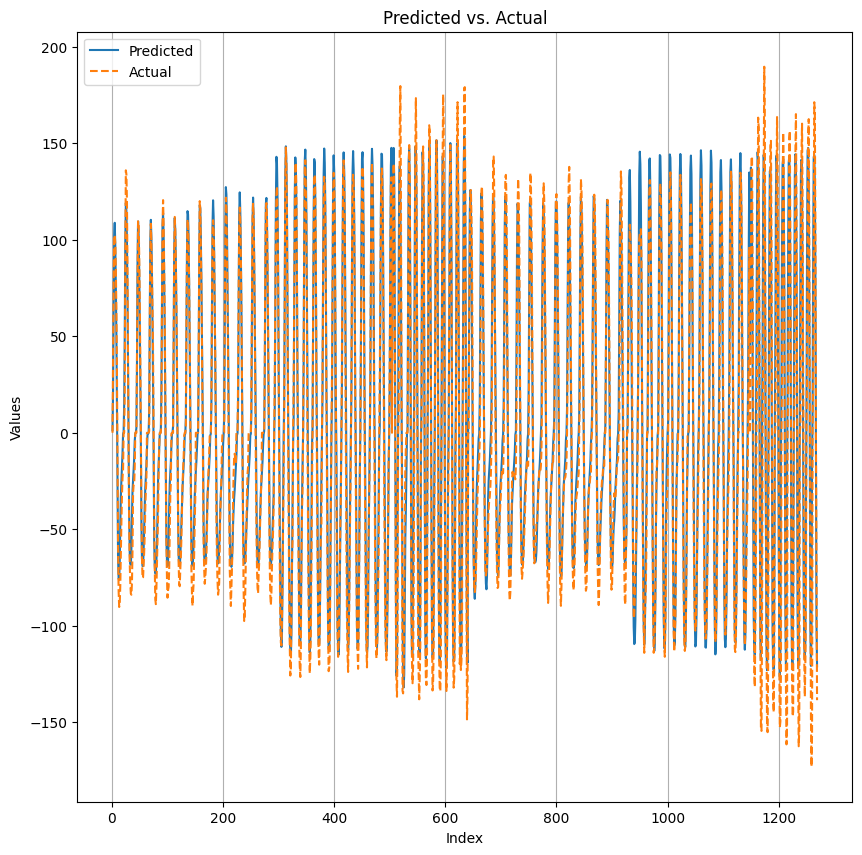

In [8]:
ResultadosRegressao(Resultados1Matrix[0],Resultados1Matrix[1],Resultados1Matrix[4])

# Exercicio 2 Matrix

In [10]:
exer="2"
Resultados2Matrix = getMatrix(exer, file_path, users1,repetition, pesos)

the user user is  AntonioC  try nº  R1  peso:  3kg
Offset Inicial =  1.3499999999999952
Tempo Input =  34.313  Tempo Output =  31.324
----------------------------------
the user user is  AntonioC  try nº  R2  peso:  3kg
Offset Inicial =  1.4999999999999947
Tempo Input =  33.962  Tempo Output =  31.488
----------------------------------
the user user is  AntonioC  try nº  R3  peso:  3kg
Offset Inicial =  1.0499999999999963
Tempo Input =  34.138  Tempo Output =  31.713
----------------------------------
the user user is  AntonioC  try nº  R4  peso:  3kg
Offset Inicial =  1.5999999999999943
Tempo Input =  37.628  Tempo Output =  33.479
----------------------------------
the user user is  GusC  try nº  R1  peso:  3kg
Offset Inicial =  1.200000000000001
Tempo Input =  34.752  Tempo Output =  31.698
----------------------------------
the user user is  GusC  try nº  R2  peso:  3kg
Offset Inicial =  1.100000000000001
Tempo Input =  30.874  Tempo Output =  28.562
-------------------------------

# Exercicio 2 Cross Validation Pesos

SCENE 0  TRAIN: [2992 3690 4305 ... 4476 4312 4938]  TEST: [   0    1    2 ... 2603 2604 2605]
min_v,max_v: -7.0210001470000005 14.463523387999999 [[-3.40212548e+00 -2.96862686e+00 -9.07712460e-01 ...  4.07153338e-01
   7.13715851e-01  1.26936042e+00]
 [-2.47166038e+00 -3.87274671e+00 -4.60322762e+00 ... -5.15048981e+00
  -4.55053723e+00 -4.64154792e+00]
 [-1.30768073e+00 -2.92192388e+00 -3.26680684e+00 ...  2.05732179e+00
   3.27159691e+00  2.30640387e+00]
 ...
 [ 7.20900893e-01  2.11959243e+00  2.81774068e+00 ... -4.68106580e+00
  -4.28708506e+00 -2.49082041e+00]
 [ 1.47533214e+00  2.65368176e+00  2.41537726e+00 ... -1.91122568e+00
  -6.03544950e-01  2.39502100e-03]
 [-3.35302758e+00 -3.80808130e-01  6.27974129e+00 ...  3.47397614e+00
   2.80337048e+00  2.09085202e+00]]
normal [[0.168441   0.18861825 0.28454379 ... 0.34574439 0.36001338 0.38587593]
 [0.21174962 0.14653587 0.11253554 ... 0.08706315 0.11498802 0.11075192]
 [0.26592721 0.19079205 0.17473943 ... 0.4225517  0.4790703  0.4

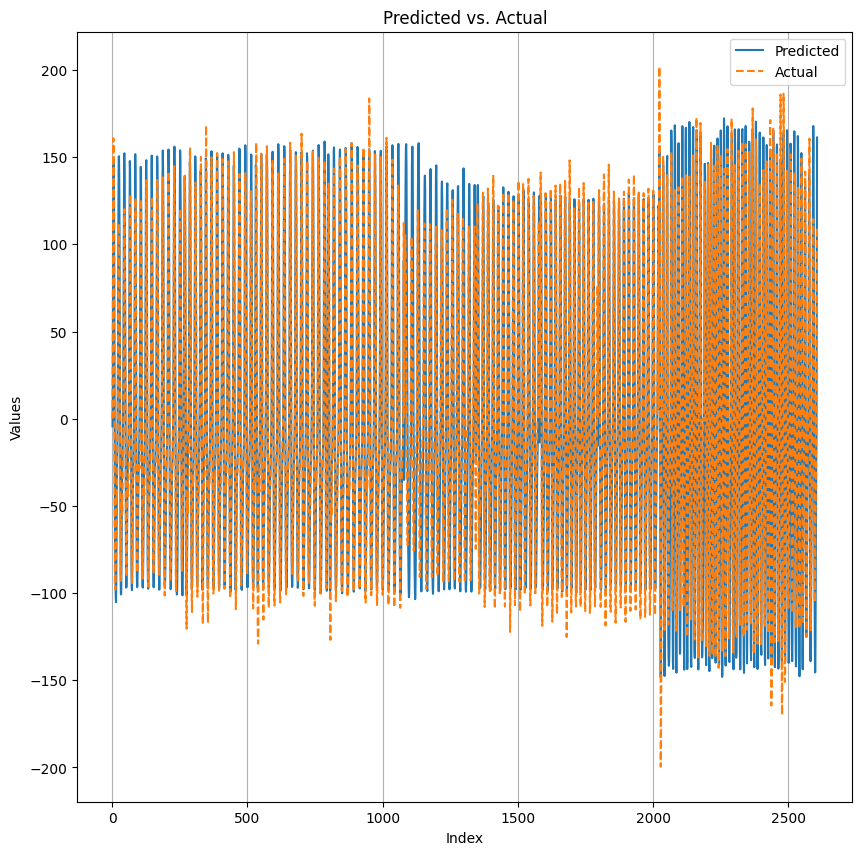

SCENE 1  TRAIN: [1591 1649 1064 ...  166 1439 2232]  TEST: [2606 2607 2608 ... 5081 5082 5083]
min_v,max_v: -6.267766476 7.807764053 [[ 0.4023633   2.16270274  2.32077408 ...  2.4369325  -0.06945557
  -1.6585511 ]
 [ 3.62725723  4.23080206  3.47996354 ... -0.89334232 -0.5484595
   0.19399659]
 [-4.0715332  -3.33865738 -2.72553229 ... -3.29554701 -2.31239152
  -0.64905029]
 ...
 [-1.45497441 -3.12669814 -2.96263933 ... -4.39366364 -4.2691226
  -2.89078879]
 [ 3.53504908  3.44164324  3.34344745 ... -3.24764669 -2.03816175
  -0.2574646 ]
 [ 1.29091561  2.90755391  5.13731718 ...  0.63228518  3.56378913
   1.72441411]]
normal [[0.47388123 0.59894504 0.61017526 ... 0.61842777 0.44036073 0.32746299]
 [0.70299472 0.74587374 0.6925302  ... 0.38182747 0.40632976 0.45907776]
 [0.15603201 0.20809937 0.25165902 ... 0.21116216 0.28101072 0.39918326]
 ...
 [0.34192616 0.22315808 0.23481368 ... 0.13314616 0.14199421 0.23991832]
 [0.69644377 0.68980773 0.68283138 ... 0.21456525 0.30049345 0.42700358]


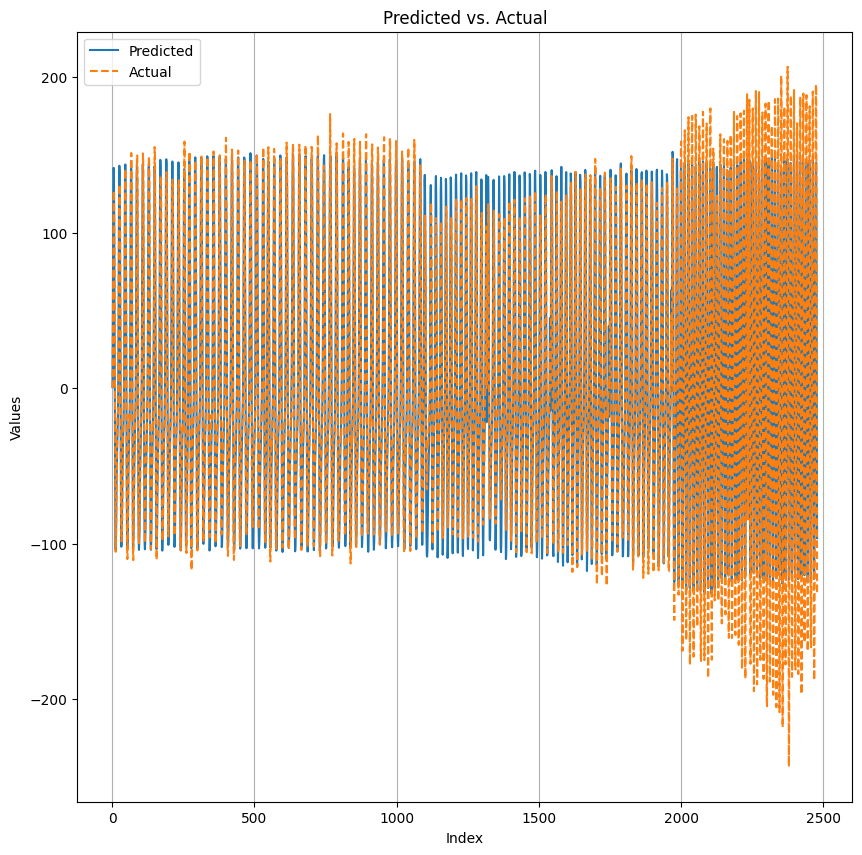

In [11]:
ResultadosRegressao(Resultados2Matrix[0],Resultados2Matrix[1],Resultados2Matrix[2])

# Exercicio 2 Cross Validation Utilizadores

SCENE 0  TRAIN: [1531 3769 4958 ... 1645 4803 2441]  TEST: [   0    1    2 ... 3696 3697 3698]
min_v,max_v: -5.350473881 14.463523387999999 [[ 4.62957287  4.63675785  4.87985253 ... -0.01916016 -2.82133305
  -3.37218761]
 [-0.39637576  0.4143384   1.81542486 ... -1.8369801  -2.64170659
  -3.13388312]
 [ 0.19160157 -2.42855    -1.83458507 ...  4.60562277  4.80680418
   1.50646734]
 ...
 [-0.06945557  1.94715095  3.24644911 ... -0.98195803 -3.0787977
  -3.53025889]
 [ 1.03943855 -1.00351325 -3.12789559 ... -2.25491095 -2.16030765
  -0.10178833]
 [ 1.80344975  3.78413105  2.79738283 ...  1.28852057  0.87178713
   1.95553356]]
normal [[0.50368669 0.50404931 0.51631815 ... 0.26906806 0.12764415 0.09984287]
 [0.25003022 0.29094646 0.36165841 ... 0.17732382 0.13670978 0.11186994]
 [0.27970507 0.14746766 0.1774447  ... 0.50247795 0.51263145 0.34606552]
 ...
 [0.26652968 0.36830654 0.43388131 ... 0.22047625 0.11465007 0.09186511]
 [0.32249487 0.21938837 0.11217213 ... 0.15623112 0.16100569 0.26

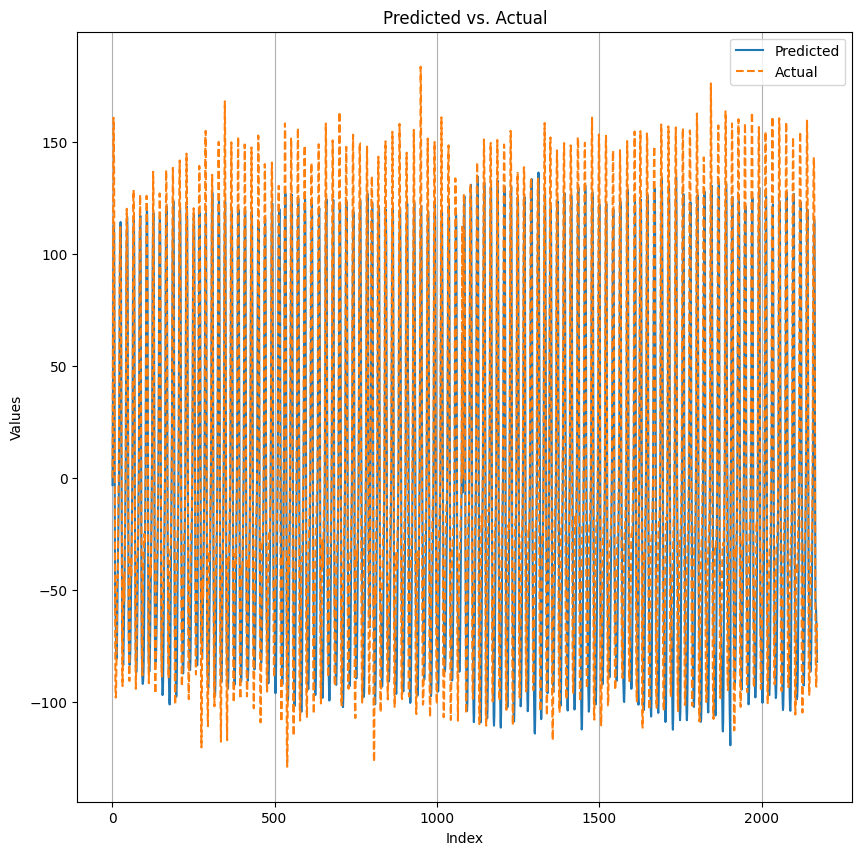

SCENE 1  TRAIN: [ 412 3049 1046 ...  486 2956  353]  TEST: [1078 1079 1080 ... 4568 4569 4570]
min_v,max_v: -7.0210001470000005 14.463523387999999 [[-5.70373917 -4.86188984 -4.38288593 ... -1.78907967 -0.3281177
   1.22265756]
 [-2.13396245 -2.3519094  -4.75650907 ... -6.07975721 -5.21156263
  -5.08103418]
 [ 0.7592212   1.65974855  2.10043216 ...  2.18904793  2.28724384
   2.69679213]
 ...
 [ 2.92192388  1.79865974  1.78189456 ...  0.01077758 -0.28261232
  -2.51716566]
 [ 1.44778937  1.63100839  1.36755621 ...  1.60346568  0.73766607
   1.28971803]
 [-3.73024309 -2.74948263 -1.76393199 ...  1.13404179  2.13037002
   2.3614893 ]]
normal [[0.06131209 0.10049608 0.12279138 ... 0.24352043 0.3115211  0.38370214]
 [0.22746782 0.21732345 0.10540104 ... 0.04381028 0.08422051 0.09029597]
 [0.36213144 0.4040466  0.42455828 ... 0.42868291 0.43325345 0.45231593]
 ...
 [0.46279472 0.41051224 0.4097319  ... 0.32729503 0.31363916 0.20963157]
 [0.39418093 0.40270889 0.39044647 ... 0.40142691 0.361128

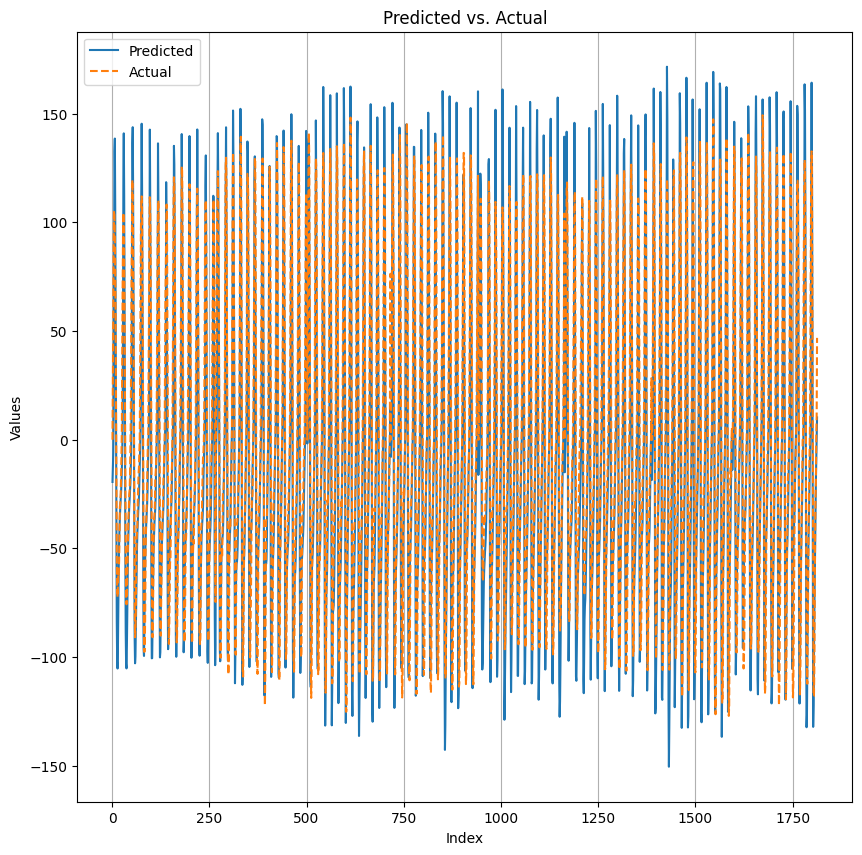

SCENE 2  TRAIN: [4208 1812 1728 ... 3690 3054 3502]  TEST: [2019 2020 2021 ... 5081 5082 5083]
min_v,max_v: -7.0210001470000005 6.849756241 [[ 1.54957771  2.44771004  2.59620118 ... -2.11599982 -0.3999683
  -0.88615727]
 [ 3.34344733  3.26920176  2.79738283 ... -1.7914747  -0.43589357
   0.1101709 ]
 [-2.61057138 -2.62613904 -1.07057381 ...  3.63324475  3.94459736
   3.80568624]
 ...
 [-2.47166038 -3.87274671 -4.60322762 ... -5.15048981 -4.55053723
  -4.64154792]
 [-3.96615243 -4.8702724  -3.46559334 ... -2.70517468 -1.38671637
  -0.17244142]
 [-5.66422153 -5.96838903 -4.44036627 ... -3.424878   -1.59747815
  -0.75203615]]
normal [[0.61788828 0.68263834 0.69334368 ... 0.35362169 0.47733748 0.44228611]
 [0.74721574 0.74186307 0.7078477  ... 0.37701804 0.47474748 0.51411551]
 [0.31796599 0.31684365 0.42899076 ... 0.76810843 0.79055512 0.78054045]
 ...
 [0.32798066 0.22697057 0.17430719 ... 0.1348528  0.17810585 0.17154452]
 [0.22023656 0.15505483 0.25632393 ... 0.31114565 0.40619874 0.49

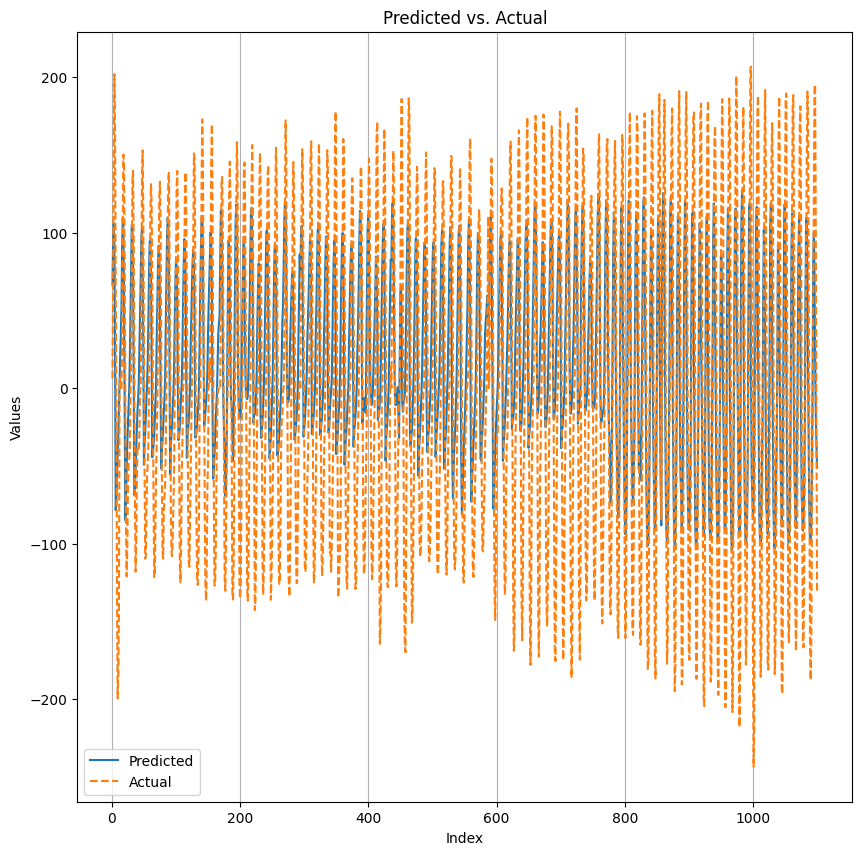

In [12]:
ResultadosRegressao(Resultados2Matrix[0],Resultados2Matrix[1],Resultados2Matrix[3])

# Exercicio 2 Cross Validation Repeticoes

SCENE 0  TRAIN: [1918 2246  970 ... 2325  473  660]  TEST: [   0    1    2 ... 4712 4713 4714]
min_v,max_v: -7.0210001470000005 14.463523387999999 [[ 3.11232805  3.15903091  3.53504896 ... -1.31127322 -3.25243676
  -3.5685792 ]
 [ 3.19375873  2.79977798  2.78061771 ... -3.22130132  1.11368418
   1.84177014]
 [ 2.57464612  0.28979737 -1.83458507 ... -5.31215334 -5.96120405
  -4.38288593]
 ...
 [ 0.20477417  3.55660415  1.58909553 ... -1.08374637  2.65368176
   2.48004287]
 [-5.09420657 -5.43908978 -5.17563748 ... -4.30864048 -3.03209484
  -3.07041526]
 [-4.37091088 -5.5564456  -6.12047267 ... -4.03920066 -3.08957529
  -2.54111576]]
normal [[0.47165711 0.4738309  0.49133271 ... 0.26576    0.17540828 0.16069339]
 [0.47544731 0.45710942 0.4562176  ... 0.17685749 0.37862996 0.41251882]
 [0.44663063 0.34028204 0.24140238 ... 0.0795385  0.04932835 0.12279138]
 ...
 [0.33632462 0.492336   0.40075805 ... 0.27635027 0.45030935 0.44222731]
 [0.08968286 0.07363023 0.08589265 ... 0.12624714 0.18566

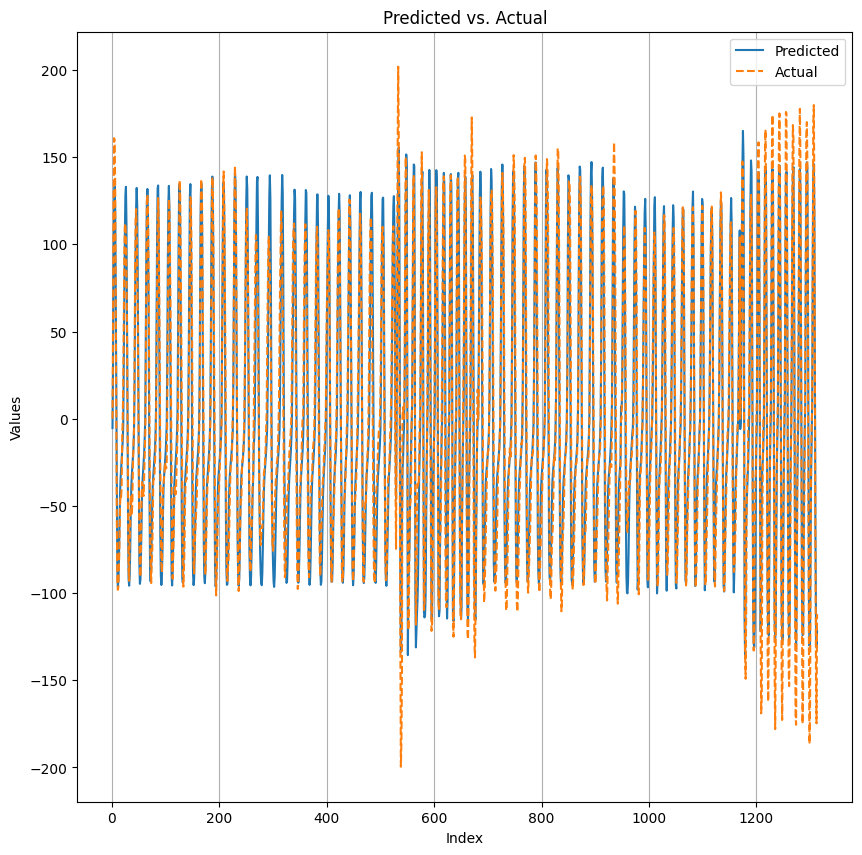

SCENE 1  TRAIN: [4343 2415 3200 ... 2329 4976 2599]  TEST: [ 263  264  265 ... 4838 4839 4840]
min_v,max_v: -7.0210001470000005 14.463523387999999 [[ 0.08382568  1.92080569  2.43573499 ...  2.00343388 -0.62031007
  -1.19152224]
 [ 2.51596808  3.96854758  2.6417067  ...  2.84528327  2.64050925
   2.43813002]
 [-4.2787025  -6.23663115 -5.51573038 ... -3.88472188 -4.95769072
  -4.61280775]
 ...
 [ 1.02027833  0.28740236 -1.81781995 ...  1.88847303  5.4199295
   1.72201908]
 [ 0.93166262  4.11584139  2.34711933 ...  4.84272957  3.41410053
   0.01077759]
 [ 0.48618898  2.40699482  2.96263933 ...  3.03688478  0.63707525
  -1.21666992]]
normal [[0.33069506 0.41619754 0.44016499 ... 0.42004348 0.29792097 0.27133382]
 [0.44389945 0.51150996 0.44975197 ... 0.45922747 0.44969624 0.44027647]
 [0.12764061 0.03650856 0.07006298 ... 0.14597849 0.09603701 0.11208963]
 ...
 [0.37428237 0.34017056 0.24218271 ... 0.41469261 0.57906472 0.40694499]
 [0.37015774 0.51836577 0.43604036 ... 0.55219887 0.485703

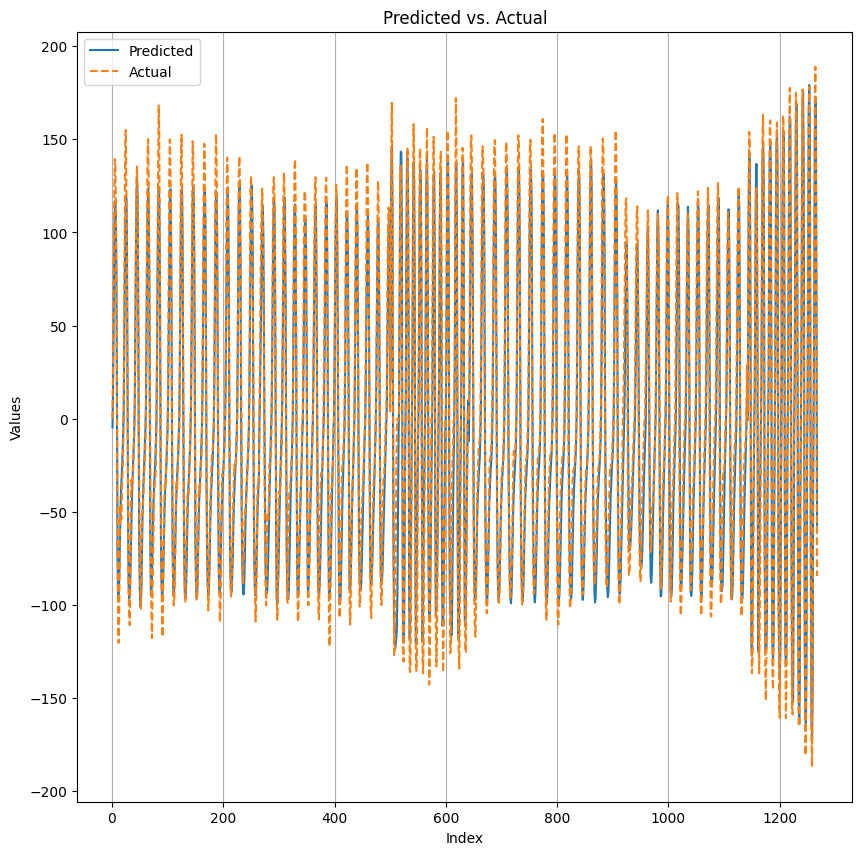

SCENE 2  TRAIN: [2135 3818 1966 ... 2992 3135 1267]  TEST: [ 527  528  529 ... 4961 4962 4963]
min_v,max_v: -6.512058258 14.463523387999999 [[-2.08725965 -3.16142583 -2.74109995 ...  0.35925293  4.97685099
   3.9146595 ]
 [-3.13388312 -2.56027603 -0.77239382 ...  3.14585829  1.69567394
   3.06802011]
 [-3.25243676 -3.5685792  -2.2010231  ...  3.38895273  3.4572109
   3.06083512]
 ...
 [-3.40212548 -2.96862686 -0.90771246 ...  0.40715334  0.71371585
   1.26936042]
 [ 2.22018313 -0.98315558 -2.08127212 ... -3.19136357 -4.49545193
  -6.10131264]
 [ 3.19375861  2.54470837  3.24046159 ...  3.46319842  4.44276142
   3.53504896]]
normal [[0.21094998 0.15973967 0.17977849 ... 0.3275862  0.5477278  0.49708837]
 [0.16105275 0.18839917 0.27363553 ... 0.46043617 0.39129939 0.45672528]
 [0.15540077 0.14032884 0.20552637 ... 0.47202558 0.47527975 0.45638274]
 ...
 [0.14826444 0.16893126 0.26718429 ... 0.32986983 0.34448504 0.37097511]
 [0.41630509 0.26358757 0.21123544 ... 0.1583124  0.09614066 0.01

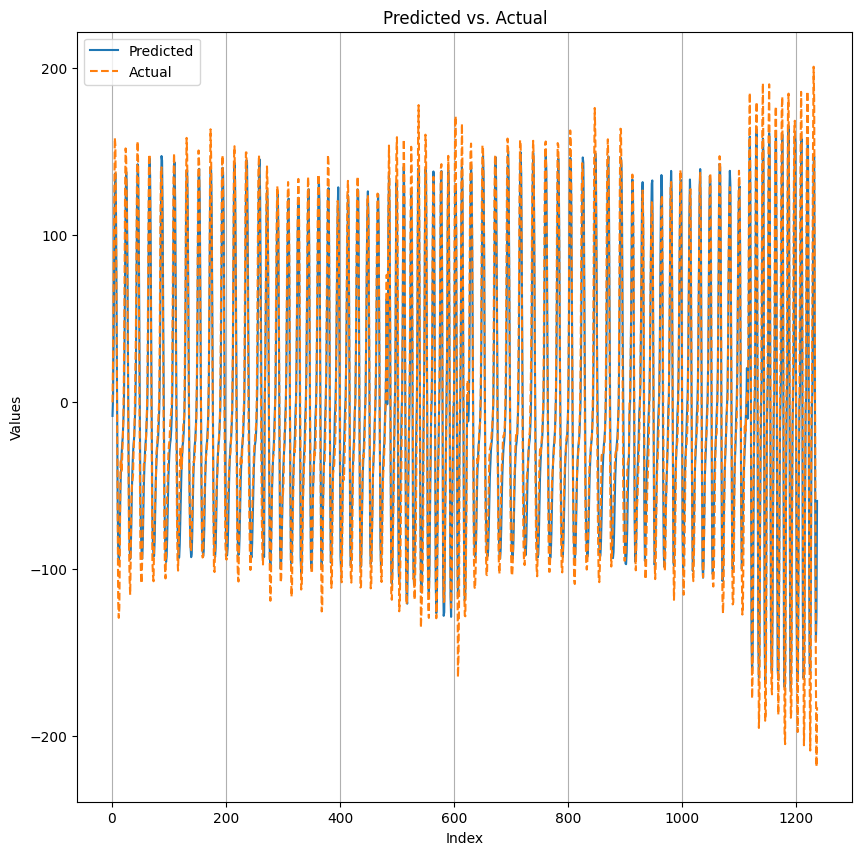

SCENE 3  TRAIN: [1269 1496 1441 ... 2145 1657 2875]  TEST: [ 794  795  796 ... 5081 5082 5083]
min_v,max_v: -7.0210001470000005 10.765613556 [[ 3.24046159  4.40444112  3.76018083 ...  3.53504896  3.68593526
   1.31486583]
 [ 4.09189105  3.58773947  3.50870371 ... -3.3793726  -1.51604748
  -0.51852176]
 [ 3.34344745  2.86683845  1.7459693  ... -0.2574646   0.9532178
   0.87058961]
 ...
 [ 2.84528339  1.81542486  0.71611088 ...  0.99153811  3.85598159
   3.21770883]
 [-1.22385502 -2.34831667 -2.7638526  ...  2.72313738  2.78061771
   2.6201514 ]
 [-0.36883303  0.63228516 -0.56043458 ... -4.88583994 -5.42471933
  -5.78277493]]
normal [[0.57692048 0.6423618  0.60614017 ... 0.59348279 0.60196593 0.46865953]
 [0.6247896  0.59644516 0.5920016  ... 0.20473979 0.30949976 0.36558271]
 [0.58271056 0.55591462 0.49289705 ... 0.38025988 0.44832693 0.44368141]
 ...
 [0.55470275 0.49680199 0.43499629 ... 0.45048138 0.61152628 0.57564127]
 [0.32592742 0.26270787 0.23934559 ... 0.54783545 0.55106711 0.5

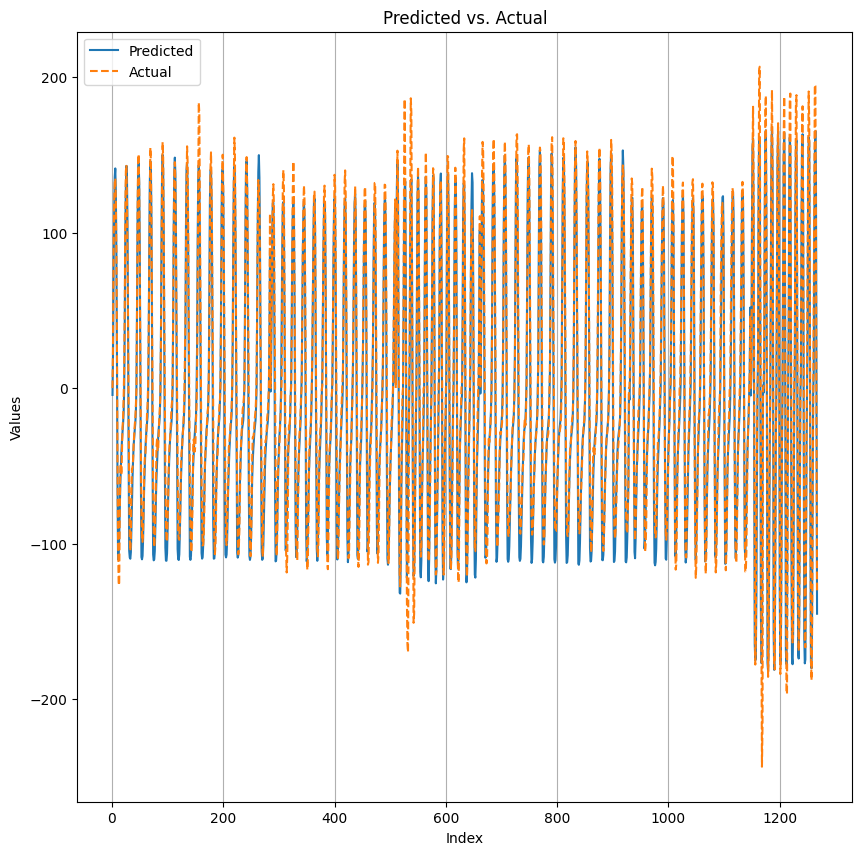

In [22]:
ResultadosRegressao(Resultados2Matrix[0],Resultados2Matrix[1],Resultados2Matrix[4])

# Exercicio 3 Matrix

In [14]:
exer="3"
Resultados3Matrix = getMatrix(exer, file_path, users1,repetition, pesos)

the user user is  AntonioC  try nº  R1  peso:  3kg
Offset Inicial =  2.3499999999999917
Tempo Input =  35.499  Tempo Output =  31.994
----------------------------------
the user user is  AntonioC  try nº  R2  peso:  3kg
Offset Inicial =  1.8499999999999934
Tempo Input =  35.611  Tempo Output =  32.667
----------------------------------
the user user is  AntonioC  try nº  R3  peso:  3kg
Offset Inicial =  1.7999999999999936
Tempo Input =  35.192  Tempo Output =  32.097
----------------------------------
the user user is  AntonioC  try nº  R4  peso:  3kg
Offset Inicial =  1.7499999999999938
Tempo Input =  34.395  Tempo Output =  31.422
----------------------------------
the user user is  GusC  try nº  R1  peso:  3kg
Offset Inicial =  0.6999999999999975
Tempo Input =  31.16  Tempo Output =  29.148
----------------------------------
the user user is  GusC  try nº  R2  peso:  3kg
Offset Inicial =  0.8999999999999968
Tempo Input =  31.338  Tempo Output =  29.286
------------------------------

# Exercicio 3 Cross Validation Pesos

SCENE 0  TRAIN: [2958 4610 4728 ... 4733 5120 2860]  TEST: [   0    1    2 ... 2856 2857 2858]
min_v,max_v: -8.0879812245 3.42487812 [[-1.76632696 -2.05971694 -1.22864509 ... -1.53520763 -3.16741347
  -2.71355724]
 [ 1.84177005  0.39877076  0.22752686 ... -0.122146    0.35206789
  -0.08143067]
 [-0.77838138 -0.0862207   0.53408939 ...  0.84065187  0.11735597
  -0.45984376]
 ...
 [ 0.10538086 -1.89206553 -1.39988899 ...  0.13891114 -1.37234628
  -0.07185059]
 [-0.23710694  1.5938856   1.40946907 ... -1.87769544  0.60474244
   0.35925296]
 [-2.44771004 -0.4406836  -0.57959473 ... -0.69216067 -0.6610254
  -1.97828627]]
normal [[0.54909507 0.52361139 0.59579779 ... 0.56916995 0.42739754 0.46681922]
 [0.86249219 0.73715415 0.72228    ... 0.69190763 0.73309756 0.69544414]
 [0.63490742 0.69502808 0.74890784 ... 0.77553567 0.71271063 0.66257541]
 ...
 [0.71167048 0.53817349 0.58092365 ... 0.7145829  0.58331599 0.69627626]
 [0.68192219 0.8409611  0.82494279 ... 0.53942167 0.75504472 0.73372165]

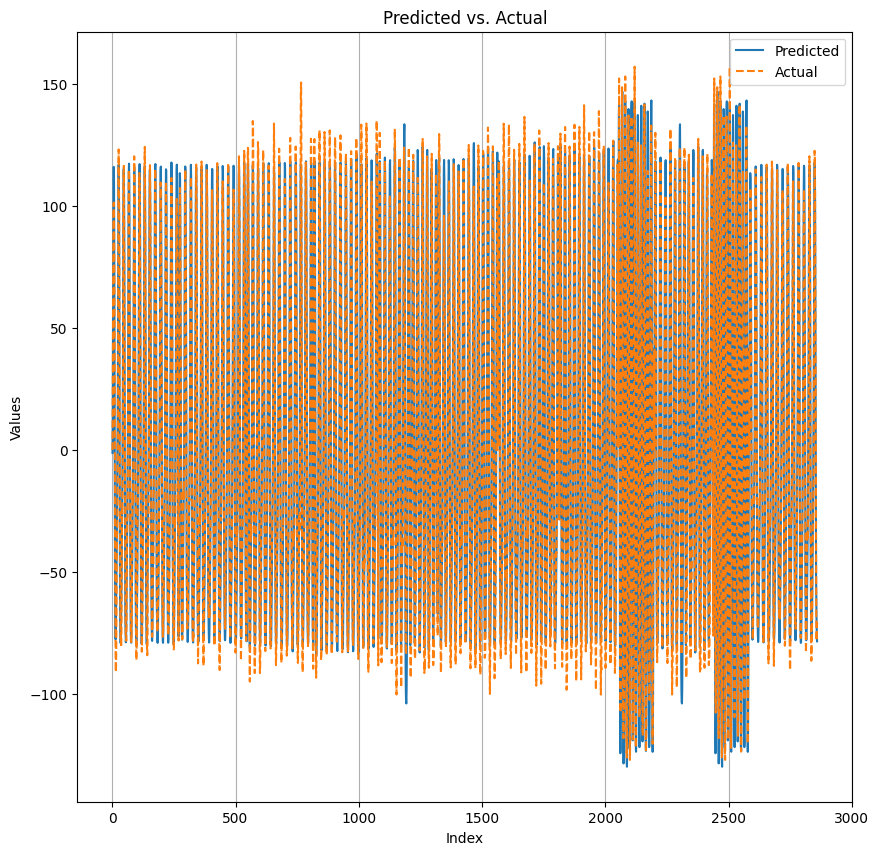

SCENE 1  TRAIN: [2840 2832 2234 ... 1319  539  767]  TEST: [2859 2860 2861 ... 5532 5533 5534]
min_v,max_v: -8.168214321499999 3.527863979 [[-3.45840836 -3.35063243 -2.70637226 ... -1.36995125 -1.77949953
  -0.09101075]
 [-6.19112587 -3.42248297 -3.06562507 ... -1.41306162 -1.86572033
  -2.13875246]
 [-0.82268924 -0.73048097 -1.56514531 ...  0.99872318  1.03345096
   1.76752448]
 ...
 [-0.64066774 -0.07664062 -0.4766089  ... -1.4837147  -1.35677862
  -1.71962404]
 [-6.57552648 -3.38176775 -3.74341559 ... -2.36627936 -3.14945078
  -1.84416509]
 [-6.2965064  -8.16821432 -6.55516863 ... -1.22145999 -1.91960818
  -3.31710219]]
normal [[0.40268249 0.4118972  0.46698063 ... 0.58124295 0.54622709 0.69059076]
 [0.16903858 0.40575407 0.43626497 ... 0.57755707 0.53885532 0.51551141]
 [0.62803317 0.63591686 0.5645541  ... 0.78376164 0.78673082 0.84949318]
 ...
 [0.64359578 0.69181939 0.6576226  ... 0.57151632 0.58236919 0.55134637]
 [0.13617281 0.40923517 0.37831473 ... 0.49605815 0.42909798 0.54

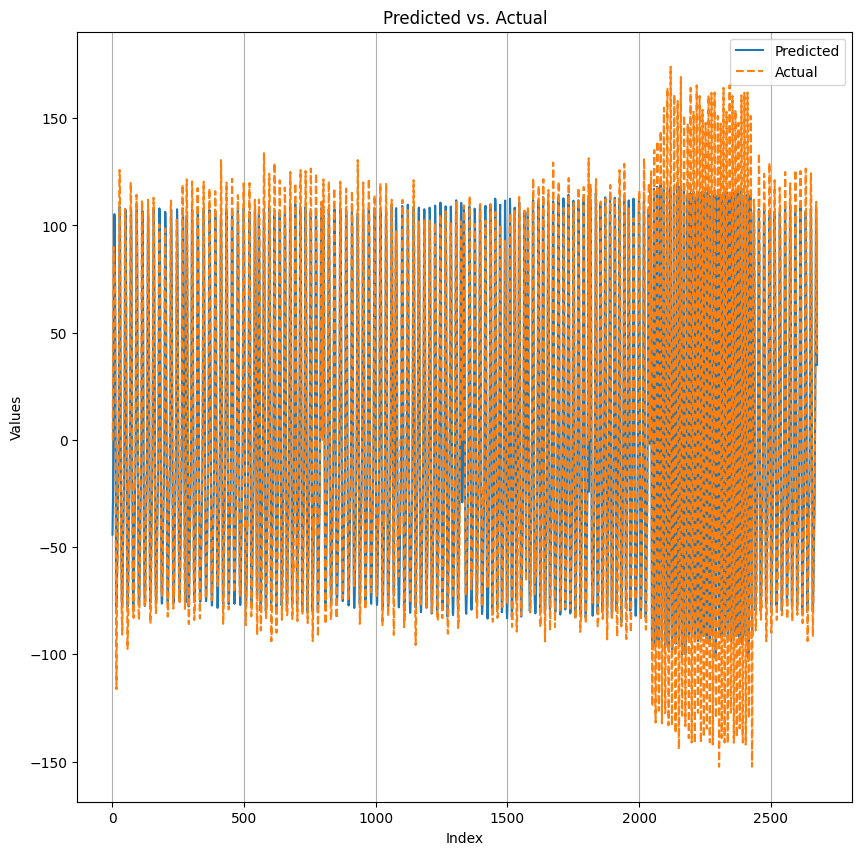

In [15]:
ResultadosRegressao(Resultados3Matrix[0],Resultados3Matrix[1],Resultados3Matrix[2])

# Exercicio 3 Cross Validation Utilizadores

SCENE 0  TRAIN: [2424 1761 5473 ... 4657 4099 2817]  TEST: [   0    1    2 ... 3926 3927 3928]
min_v,max_v: -8.0879812245 3.527863979 [[-0.39757326  0.05748047 -1.59508312 ...  1.76033938  2.17946792
  -0.0359253 ]
 [-0.88016972 -2.08246958 -1.09212899 ...  0.88495976  0.1101709
  -1.3735438 ]
 [-4.35055304 -5.68457913 -7.01501274 ... -2.02858162 -3.45122337
  -3.54462898]
 ...
 [-0.122146    0.35206789 -0.08143067 ...  1.1352393   0.89813232
  -0.5855823 ]
 [-1.55915773 -1.61424327 -0.83945438 ... -1.41665411 -2.12917256
  -2.62134898]
 [-3.35422504 -4.1840992  -3.46679091 ... -2.21539307 -2.24652839
  -1.90284312]]
normal [[0.66206185 0.70123711 0.55896906 ... 0.84783504 0.88391752 0.69319587]
 [0.62051546 0.5170103  0.60226803 ... 0.77247422 0.70577319 0.57804123]
 [0.32175258 0.20690721 0.09237111 ... 0.52164948 0.39917524 0.39113402]
 ...
 [0.68577319 0.72659793 0.68927835 ... 0.79402061 0.77360824 0.64587628]
 [0.56206185 0.55731958 0.62402061 ... 0.57432989 0.51298968 0.47061855

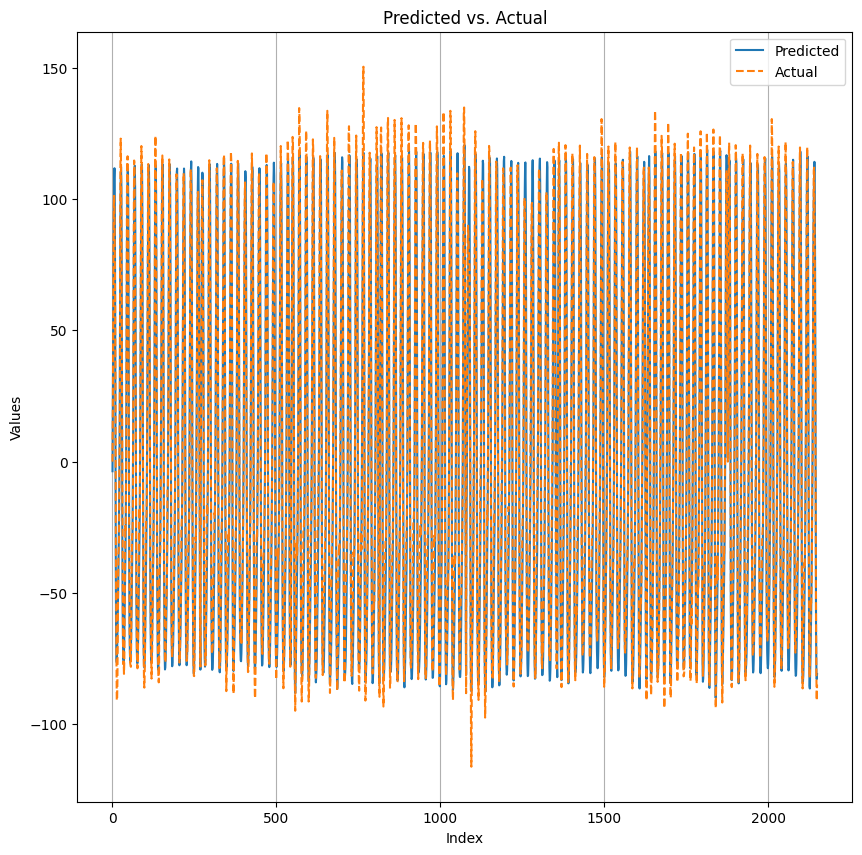

SCENE 1  TRAIN: [3118 5368  185 ... 5510 5194 2112]  TEST: [1079 1080 1081 ... 4896 4897 4898]
min_v,max_v: -8.168214321499999 3.42487812 [[-3.23327661 -3.01532972 -2.89677632 ... -2.4141798  -3.84640145
  -0.87418217]
 [-3.75179827 -2.96503425 -2.69918716 ... -4.44755125 -6.32045698
  -6.92519927]
 [-3.22369635 -3.08478534 -1.9663111  ... -3.88232684 -3.62366474
  -2.76864278]
 ...
 [-0.4622388  -1.69567394 -5.46782994 ... -4.15296388 -3.27758431
  -2.57704115]
 [-1.86811531  1.46814704  2.36627936 ...  0.48379397 -0.39996827
  -0.21195924]
 [-0.64665532 -1.10410404  0.23351441 ... -2.09803718 -5.58758068
  -4.06195307]]
normal [[0.42567915 0.44447887 0.45470508 ... 0.49633301 0.37279206 0.62917053]
 [0.38095237 0.44881727 0.47174878 ... 0.32093793 0.15938434 0.10722032]
 [0.42650552 0.43848775 0.53496539 ... 0.3696932  0.39200495 0.46575765]
 ...
 [0.66470405 0.55831008 0.23293046 ... 0.34634852 0.42185724 0.48228488]
 [0.54343559 0.83121578 0.90868711 ... 0.74630719 0.6700754  0.686

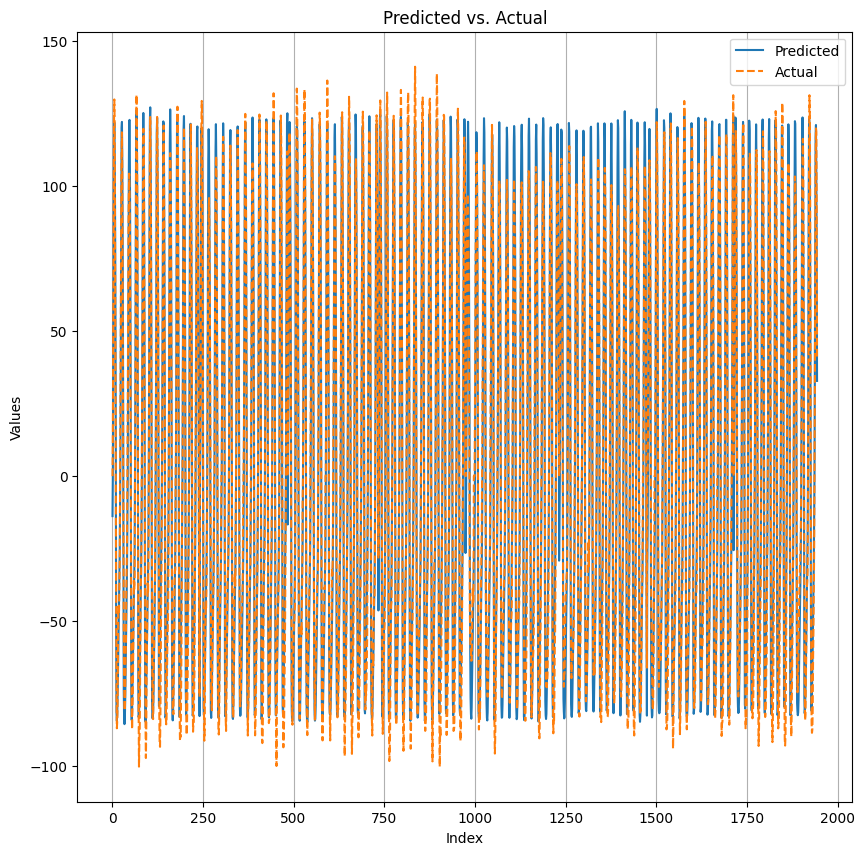

SCENE 2  TRAIN: [4736  343 4007 ... 4815 4005 1526]  TEST: [2052 2053 2054 ... 5532 5533 5534]
min_v,max_v: -8.168214321499999 3.527863979 [[-0.2814148  -0.25147706 -0.17962648 ...  0.08143067  2.13276505
   1.85853523]
 [-5.97078371 -5.75283718 -3.35063243 ... -2.40459967 -2.32915664
  -2.73750734]
 [-2.6201514  -1.19750983 -0.01077759 ... -0.21555176 -1.33761847
  -1.22145999]
 ...
 [-1.27654541 -1.69806898 -0.77119631 ... -1.22145998 -0.18082398
   1.28612554]
 [-1.1711646  -3.06323004 -2.6201514  ... -1.3819263  -1.26696539
  -0.21555176]
 [-2.96024418 -3.408113   -2.87162852 ... -0.88376226 -0.8023316
  -1.69447637]]
normal [[0.67431145 0.67687109 0.68301422 ... 0.70533428 0.88072079 0.85727449]
 [0.18787756 0.20651171 0.4118972  ... 0.49278181 0.4992321  0.46431862]
 [0.47435241 0.59598648 0.69745059 ... 0.67994266 0.58400736 0.59393877]
 ...
 [0.58922903 0.5531893  0.63243575 ... 0.59393877 0.68291184 0.80833418]
 [0.59823896 0.43646974 0.47435241 ... 0.5802191  0.59004811 0.679

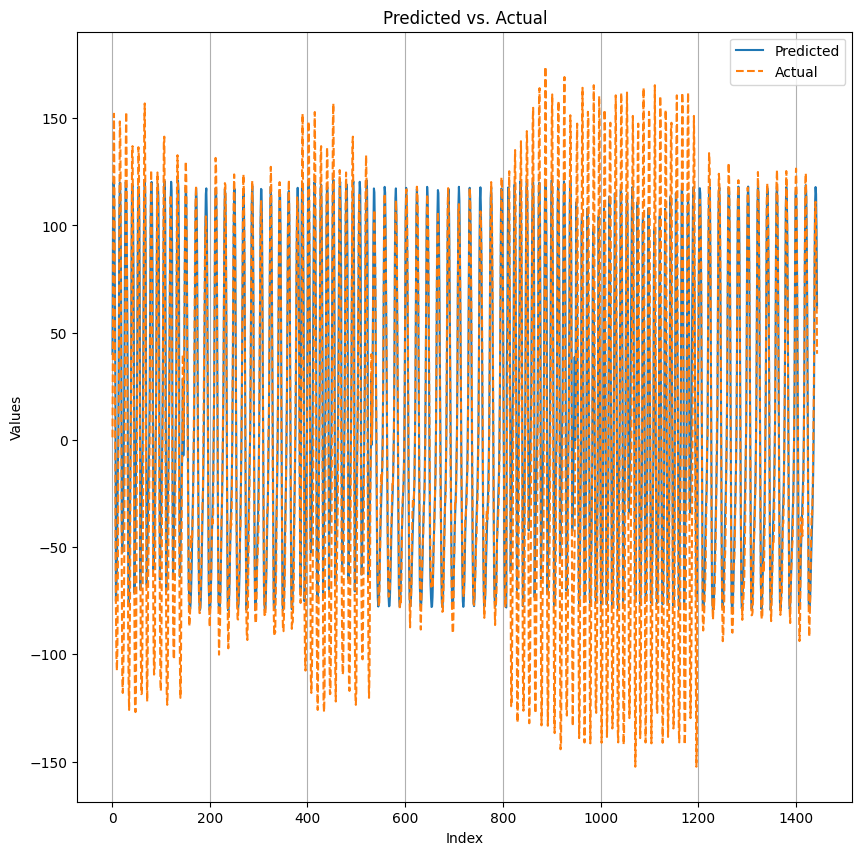

In [16]:
ResultadosRegressao(Resultados3Matrix[0],Resultados3Matrix[1],Resultados3Matrix[3])

# Exercicio 3 Cross Validation Repeticoes

SCENE 0  TRAIN: [1730 2458 3471 ... 1074  274 3361]  TEST: [   0    1    2 ... 5036 5037 5038]
min_v,max_v: -8.168214321499999 3.527863979 [[ 1.12086916  2.3614893   3.52786398 ... -0.97956306 -0.55564454
  -0.97956306]
 [-1.29570562  0.23351441  1.50886238 ... -2.25850356 -4.45713139
  -4.56610489]
 [-3.02011967  0.05748047 -0.16765137 ... -7.38384533 -6.96351957
  -4.46192169]
 ...
 [-3.51109886 -5.73726964 -6.86891651 ... -1.34121096 -1.96870613
  -2.25371349]
 [-0.58677983 -3.61528218 -4.17811179 ... -4.67268324 -5.87857556
  -5.28101826]
 [-5.74804735 -6.44020796 -4.25954246 ... -2.96503425 -0.78556645
  -1.76512945]]
normal [[0.79420497 0.90027643 1.         ... 0.61462065 0.65086515 0.61462065]
 [0.58759086 0.71833725 0.8273779  ... 0.50527285 0.31729293 0.30797583]
 [0.44015563 0.70328657 0.68403808 ... 0.06706256 0.10299989 0.31688336]
 ...
 [0.39817752 0.20784272 0.11108833 ... 0.58370021 0.53005016 0.50568239]
 [0.64820312 0.38926998 0.34114875 ... 0.29886352 0.19576124 0.24

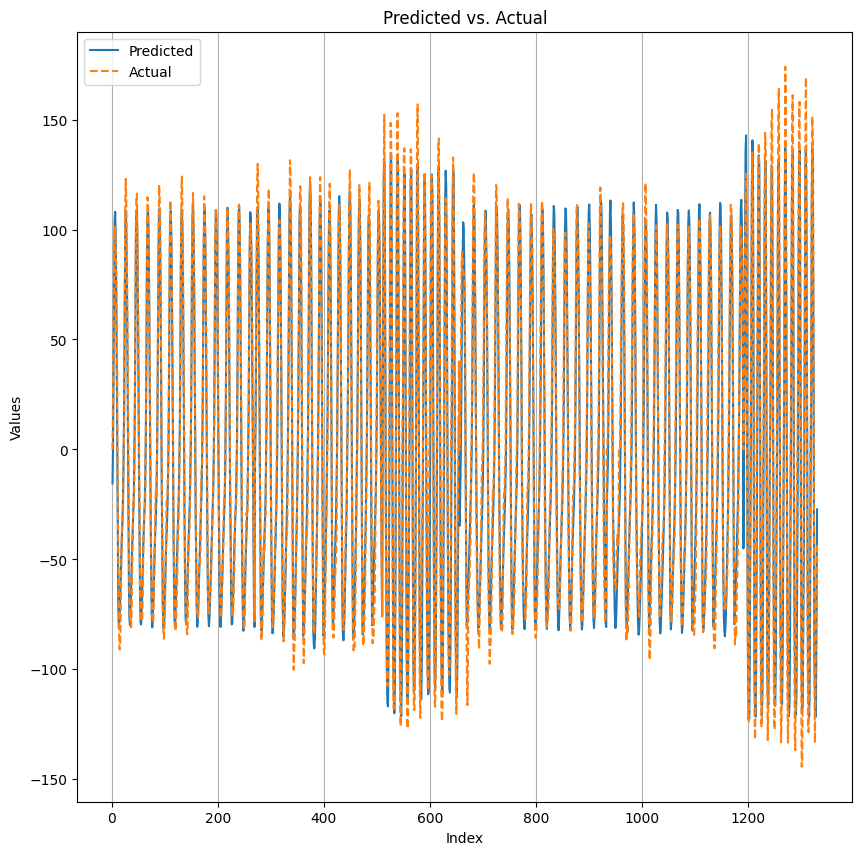

SCENE 1  TRAIN: [2035 1835 3530 ... 1831  800  163]  TEST: [ 269  270  271 ... 5161 5162 5163]
min_v,max_v: -8.168214321499999 3.527863979 [[-2.68002701 -2.18904805 -0.9891431  ... -1.64298344 -0.22273682
  -1.30528569]
 [ 2.19623303  1.32923591  0.40715334 ...  0.06346804 -1.34600103
  -1.71483409]
 [-3.72784793 -3.03089738 -2.24173832 ... -7.74908614 -6.75635052
  -4.14817381]
 ...
 [-1.02267337 -0.4742139  -1.03824103 ... -2.57704115 -1.0023157
  -1.02267337]
 [-2.99976206 -2.31837893 -2.43094492 ... -0.74724615 -1.60107058
  -2.61775637]
 [-2.55548596 -3.90388203 -2.92431903 ... -3.12550068 -3.5266664
  -2.82372808]]
normal [[0.46923312 0.5112112  0.61380157 ... 0.55789904 0.67932834 0.58677178]
 [0.88614723 0.81202006 0.73318316 ... 0.7037985  0.58329067 0.5517559 ]
 [0.37964575 0.43923414 0.50670625 ... 0.03583493 0.12071258 0.34370841]
 ...
 [0.61093477 0.65782737 0.60960376 ... 0.47803828 0.61267533 0.61093477]
 [0.44189617 0.50015358 0.49052933 ... 0.63448346 0.56148254 0.4745

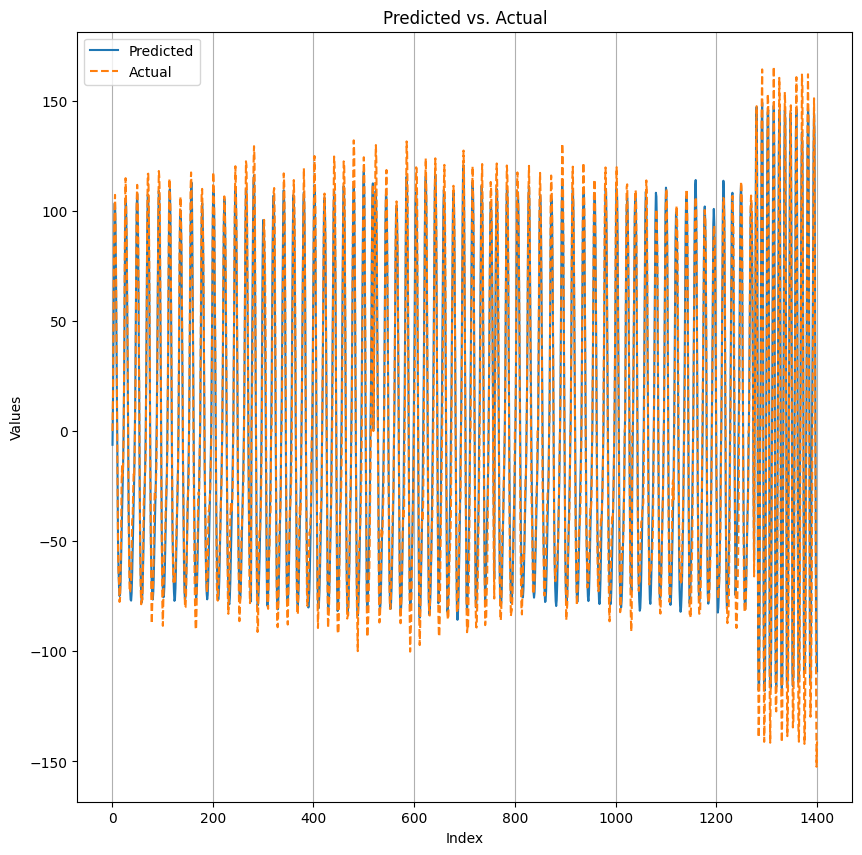

SCENE 2  TRAIN: [1489   63 2017 ... 3131 2264 5478]  TEST: [ 545  546  547 ... 5286 5287 5288]
min_v,max_v: -8.0879812245 3.42487812 [[-2.77103782 -1.12446171 -0.122146   ... -2.63931155 -1.88727546
  -1.81302988]
 [-1.91362071 -1.77111703 -0.5843848  ... -1.91601574 -3.32189226
  -4.79243422]
 [-2.02858162 -1.19271976 -0.30416749 ... -1.95673096 -1.58789802
  -0.64306277]
 ...
 [-4.12661886 -3.55181408 -2.66326189 ... -3.64761496 -1.58191049
  -1.85374516]
 [ 1.32205081 -0.4382886  -1.14841193 ... -0.80831912 -1.47293711
  -0.16286133]
 [-3.72425556 -2.24173832 -2.43214238 ... -3.62007225 -2.792593
  -3.96854758]]
normal [[0.46182649 0.60484709 0.69190763 ... 0.47326815 0.53858955 0.54503848]
 [0.53630122 0.548679   0.65175785 ... 0.53609319 0.4139796  0.28624922]
 [0.52631579 0.59891824 0.67609735 ... 0.53255669 0.5645933  0.64666111]
 ...
 [0.34408154 0.39400873 0.47118784 ... 0.38568753 0.56511337 0.54150197]
 [0.81734969 0.66444768 0.60276679 ... 0.63230705 0.57457873 0.68837112]


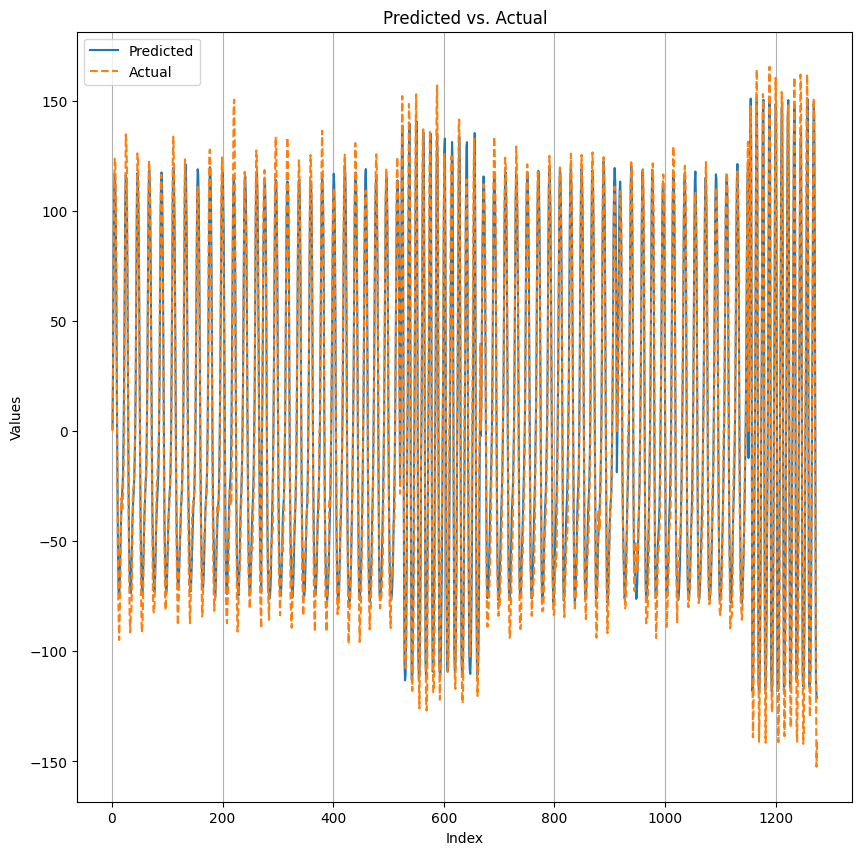

SCENE 3  TRAIN: [1542 2976 2516 ...  555 2314 2302]  TEST: [ 815  816  817 ... 5532 5533 5534]
min_v,max_v: -8.168214321499999 3.527863979 [[ 0.90531743  0.74006105  0.78556645 ... -0.64426029 -0.45026368
  -0.78796148]
 [-3.20932627 -4.54335213 -2.85965347 ... -2.1483326  -1.87530041
  -1.56993538]
 [ 1.1615845   1.04662359 -0.37601808 ... -0.12094849 -0.34009278
  -0.28261232]
 ...
 [-3.80329108 -2.38903201 -1.37713623 ... -2.2010231  -2.74229741
  -3.36380506]
 [-1.04542607 -0.95800787 -0.13891114 ... -2.25131845 -1.00351322
  -0.86460209]
 [ 1.02746344  0.62510014 -1.48730719 ... -1.38791388 -1.91242319
  -1.65256357]]
normal [[0.77577556 0.76164635 0.76553701 ... 0.64328862 0.65987508 0.63100235]
 [0.4239787  0.30992116 0.45387528 ... 0.51469232 0.53803623 0.56414456]
 [0.79768608 0.78785706 0.66622299 ... 0.68803112 0.66929456 0.67420906]
 ...
 [0.37319545 0.49411283 0.58062864 ... 0.51018735 0.46390908 0.41077096]
 [0.60898945 0.61646359 0.68649533 ... 0.50588716 0.61257294 0.62

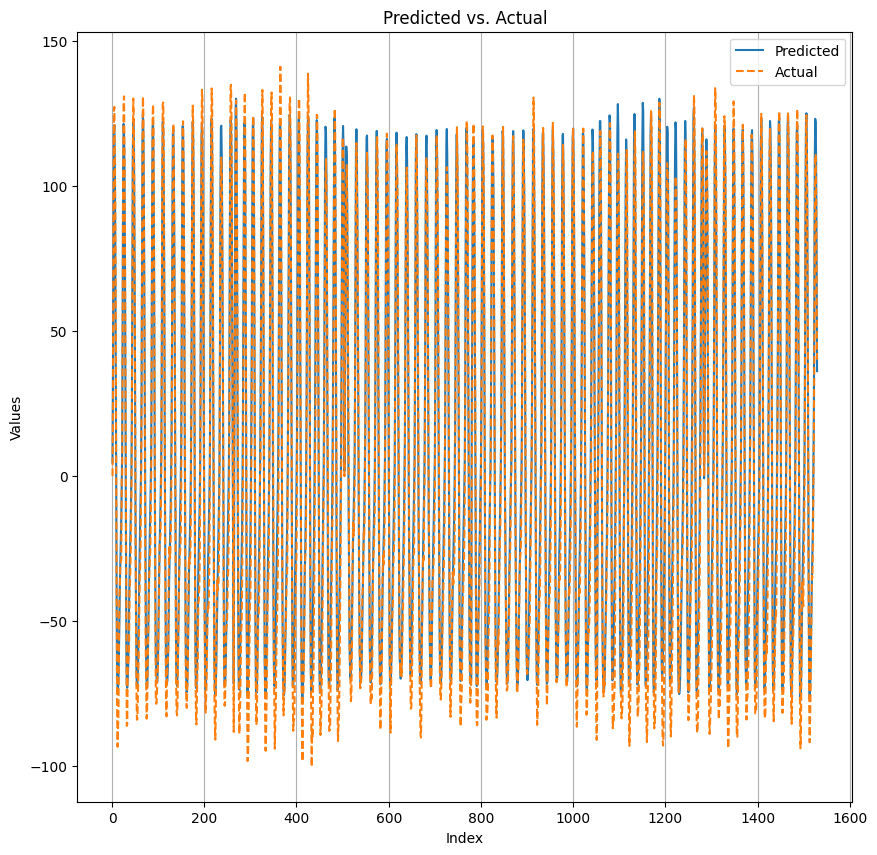

In [17]:
ResultadosRegressao(Resultados3Matrix[0],Resultados3Matrix[1],Resultados3Matrix[4])

# Exercicio 4 Matrix

In [18]:
exer="4"
Resultados4Matrix = getMatrix(exer, file_path, users1,repetition, pesos)

the user user is  AntonioC  try nº  R1  peso:  3kg
Offset Inicial =  1.8499999999999934
Tempo Input =  31.686  Tempo Output =  28.64
----------------------------------
the user user is  AntonioC  try nº  R2  peso:  3kg
Offset Inicial =  1.949999999999993
Tempo Input =  32.775  Tempo Output =  29.216
----------------------------------
the user user is  AntonioC  try nº  R3  peso:  3kg
Offset Inicial =  1.6499999999999941
Tempo Input =  34.811  Tempo Output =  30.183
----------------------------------
the user user is  AntonioC  try nº  R4  peso:  3kg
Offset Inicial =  1.399999999999995
Tempo Input =  31.612  Tempo Output =  29.076
----------------------------------
the user user is  GusC  try nº  R1  peso:  3kg
Offset Inicial =  0.5999999999999979
Tempo Input =  27.208  Tempo Output =  25.55
----------------------------------
the user user is  GusC  try nº  R2  peso:  3kg
Offset Inicial =  0.849999999999997
Tempo Input =  27.378  Tempo Output =  25.563
----------------------------------

# Exercicio 4 Cross Validation Pesos

SCENE 0  TRAIN: [2437 3499 3857 ... 2500 2992 3598]  TEST: [   0    1    2 ... 2384 2385 2386]
min_v,max_v: -10.30337429 3.558999062 [[-1.82500494 -2.47884536 -3.38655782 ... -3.50990128 -2.53393078
  -2.69918704]
 [ 0.42152346 -0.81430668 -0.51492922 ... -1.35318613 -1.33881593
  -1.67052621]
 [-0.87777472  0.17244142 -0.56043459 ... -0.14849122  1.3891114
   0.00958008]
 ...
 [-2.28963876 -2.85965347 -2.81055546 ... -3.59013438 -2.75427246
  -3.15304339]
 [-1.39869148 -2.61296654 -2.35071182 ... -2.42375994 -2.73750734
  -3.09915543]
 [-0.41194338 -0.58917484  0.32692018 ... -1.29570568 -1.27175546
  -1.76512951]]
normal [[0.61161023 0.56444367 0.49896337 ... 0.49006565 0.56046994 0.54854873]
 [0.77366967 0.6845197  0.7061161  ... 0.64564616 0.6466828  0.62275397]
 [0.67994126 0.75570146 0.70283345 ... 0.73255011 0.84346925 0.74395301]
 ...
 [0.57809261 0.53697304 0.54051486 ... 0.48427782 0.54457499 0.51580856]
 [0.64236351 0.55476848 0.57368693 ... 0.56841741 0.54578439 0.51969592]

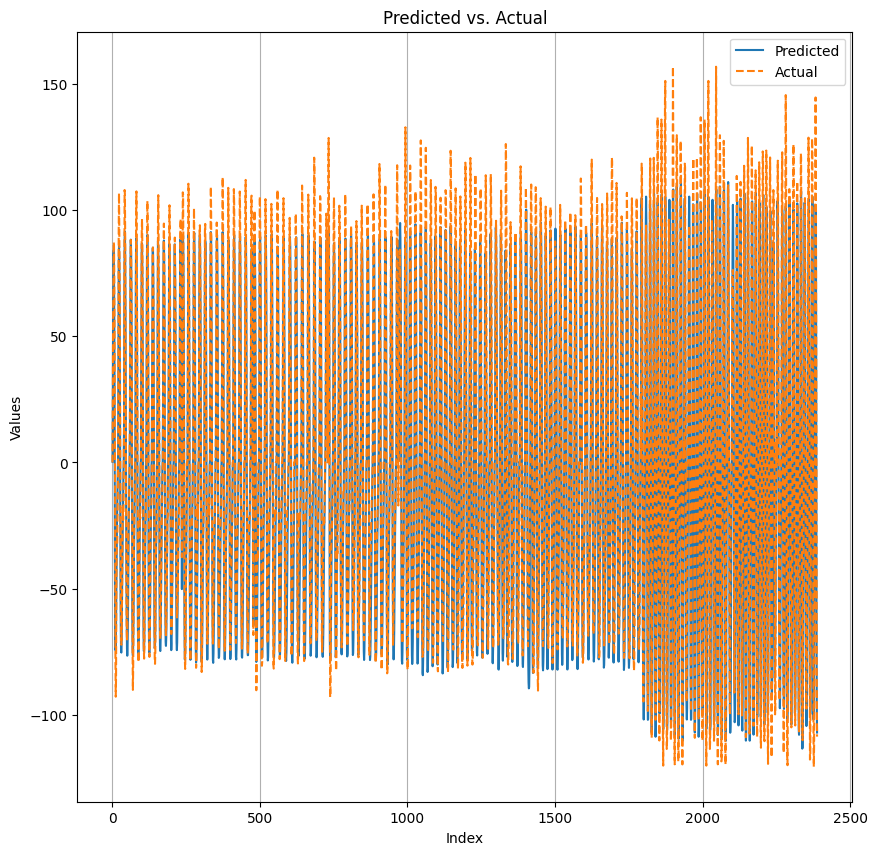

SCENE 1  TRAIN: [ 801   21 1471 ... 2259 2182 1794]  TEST: [2387 2388 2389 ... 4719 4720 4721]
min_v,max_v: -8.626860619 4.227209568 [[-3.01772475 -2.08845711 -2.8165431  ... -1.6477735  -2.40938973
  -2.48962283]
 [-0.48139894 -0.17004639 -1.76752448 ... -2.52794325 -2.74469245
  -3.37817526]
 [-0.16765137 -0.50774413 -1.89925057 ...  1.89446056  0.09340577
  -1.39150643]
 ...
 [ 0.18681154 -1.70525396 -0.91250247 ... -0.22752686 -0.07903565
  -0.67539555]
 [-0.23950197  1.19032478 -0.2203418  ...  1.76512945  0.80951664
   0.48379397]
 [ 0.76520878  0.31614259 -0.4766089  ... -1.59029308 -4.05237341
  -2.84887588]]
normal [[0.43637041 0.50866406 0.45202161 ... 0.54294764 0.48369667 0.47745482]
 [0.63368735 0.65790945 0.53363145 ... 0.47447363 0.45761133 0.40832867]
 [0.65809577 0.63163779 0.52338364 ... 0.8185206  0.67840507 0.56288429]
 ...
 [0.6856717  0.53847587 0.60014906 ... 0.65343768 0.66498975 0.61859512]
 [0.65250606 0.76374139 0.65399665 ... 0.8084591  0.7341159  0.70877586

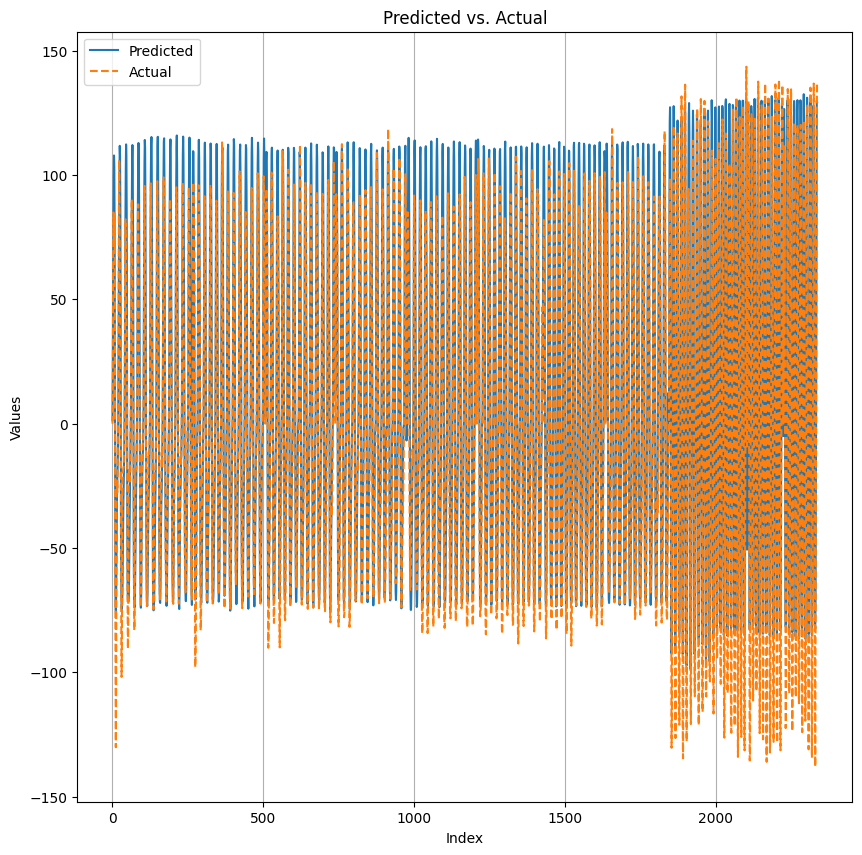

In [19]:
ResultadosRegressao(Resultados4Matrix[0],Resultados4Matrix[1],Resultados4Matrix[2])

# Exercicio 4 Cross Validation Utilizadores

SCENE 0  TRAIN: [4466 3986 4135 ... 1860 3721 2293]  TEST: [   0    1    2 ... 3358 3359 3360]
min_v,max_v: -10.30337429 4.227209568 [[ 0.69575322  0.96998295  0.96040285 ...  1.58789802  0.11136841
  -2.42974746]
 [ 0.33889528 -0.74485111 -1.38432133 ...  1.36755621  0.18561403
  -0.15807129]
 [ 0.39757326  0.95561284  0.92926765 ...  1.43461674  0.9304651
  -0.90531743]
 ...
 [ 0.74485111  2.19623303  1.03464854 ... -3.42008793 -6.12167025
  -5.46543503]
 [-2.67044687 -1.40467903  0.59875491 ... -0.1460962  -0.32572268
  -0.43230106]
 [ 0.17723145  0.20118165 -0.27183472 ... -2.49800539 -5.86779833
  -2.76984024]]
normal [[0.75696391 0.77583649 0.77517719 ... 0.81836163 0.71674633 0.54186583]
 [0.73240481 0.657821   0.61381243 ... 0.80319763 0.72185594 0.6982034 ]
 [0.73644305 0.77484754 0.77303445 ... 0.80781276 0.77311686 0.64677765]
 ...
 [0.76034284 0.86022747 0.7802868  ... 0.47371024 0.28778637 0.33294872]
 [0.52530081 0.6124114  0.75028845 ... 0.69902753 0.68666557 0.67933081]

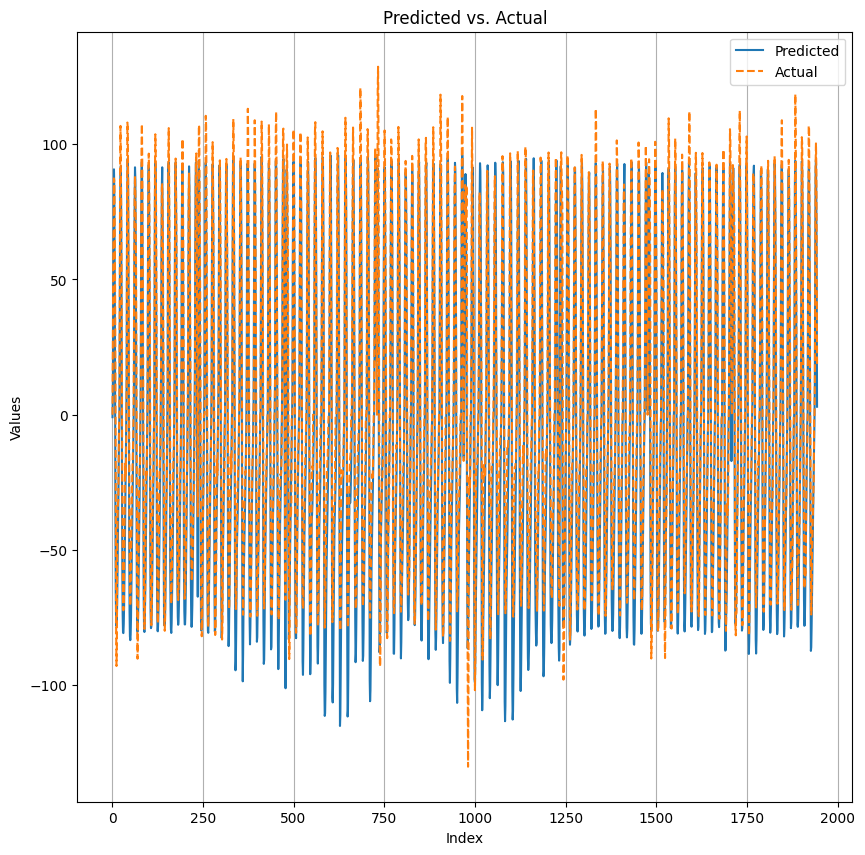

SCENE 1  TRAIN: [ 713 2445 2073 ...  610 2627 2173]  TEST: [ 969  970  971 ... 4227 4228 4229]
min_v,max_v: -10.30337429 4.227209568 [[-2.52914071 -2.41657472 -2.3902297  ... -2.15791273 -2.33514404
  -3.1314882 ]
 [-3.29075694 -3.96615243 -3.78293359 ... -1.89685559 -1.68609387
  -2.6273365 ]
 [-0.40954837 -0.01437012  0.86699712 ... -4.79363179 -3.29794192
  -0.48858401]
 ...
 [-2.66805184 -3.17579603 -2.63811421 ... -2.44890749 -3.36739755
  -2.29442882]
 [-3.10514295 -2.59620118 -3.49193859 ... -3.30273199 -4.12661886
  -3.03089738]
 [-2.62973166 -4.21643209 -5.19958782 ...  1.61783576  1.25499034
  -2.72313726]]
normal [[0.53502555 0.54277238 0.54458545 ... 0.56057359 0.54837647 0.49357178]
 [0.48261084 0.43612988 0.44873907 ... 0.57853964 0.59304433 0.52826768]
 [0.68089665 0.70809296 0.76874897 ... 0.37918246 0.48211637 0.67545739]
 ...
 [0.52546563 0.4905225  0.52752595 ... 0.54054723 0.47733641 0.5511785 ]
 [0.49538487 0.53041042 0.46876545 ... 0.48178672 0.42508653 0.50049447

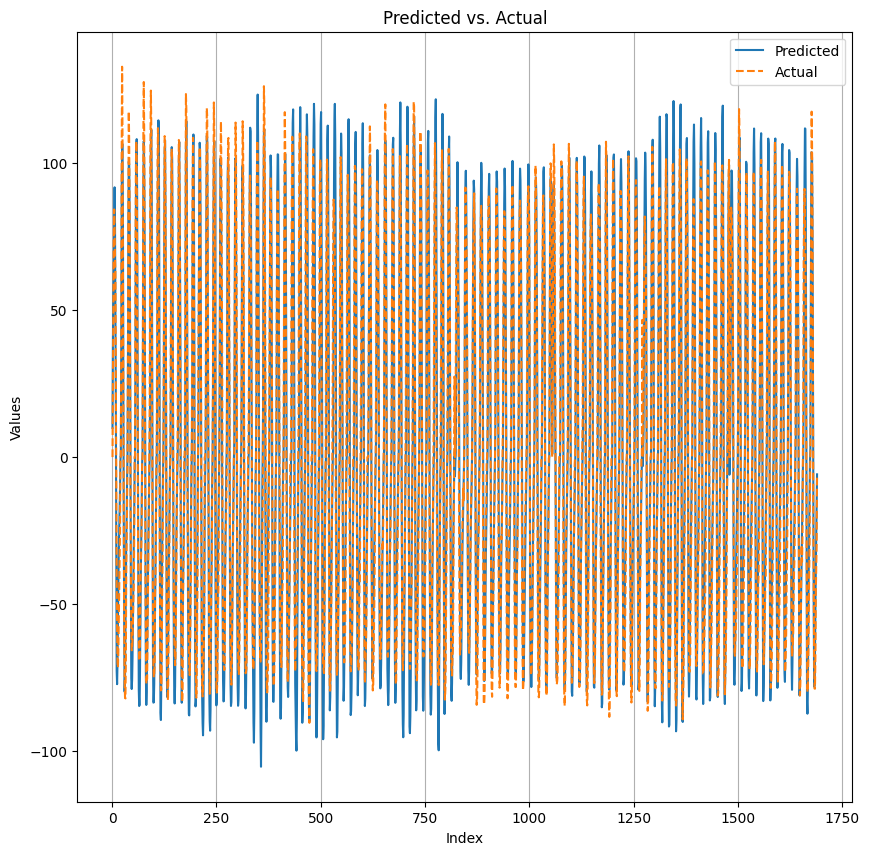

SCENE 2  TRAIN: [2892  931  349 ... 3711 2990  315]  TEST: [1790 1791 1792 ... 4719 4720 4721]
min_v,max_v: -5.8654031755 2.814148188 [[-2.95665169 -2.91234398 -2.7219398  ... -2.8273207  -3.29674458
  -3.31470716]
 [-2.82492566 -3.05245245 -3.54822159 ... -2.29442882 -2.80935812
  -2.13156748]
 [-4.2128396  -3.77814341 -2.58781874 ... -1.36276615 -2.43693256
  -2.62973154]
 ...
 [-0.28740236 -1.18673223 -1.51125741 ...  0.6945557   0.73646855
   0.3305127 ]
 [-2.3758595  -2.16749275 -1.39869148 ... -2.20461559 -2.62254643
  -2.42375994]
 [-2.06450701 -1.57592297 -2.22736835 ... -4.30265284 -2.65607667
  -1.92080569]]
normal [[0.33512694 0.34023178 0.36216888 ... 0.35002759 0.29594371 0.29387418]
 [0.35030353 0.32408942 0.2669702  ... 0.41142384 0.35209712 0.43018764]
 [0.19039735 0.24048014 0.37762141 ... 0.5187638  0.39500551 0.3727925 ]
 ...
 [0.64266004 0.53904525 0.50165563 ... 0.75579469 0.76062361 0.71385209]
 [0.40204194 0.42604857 0.51462472 ... 0.42177152 0.37362032 0.3965231

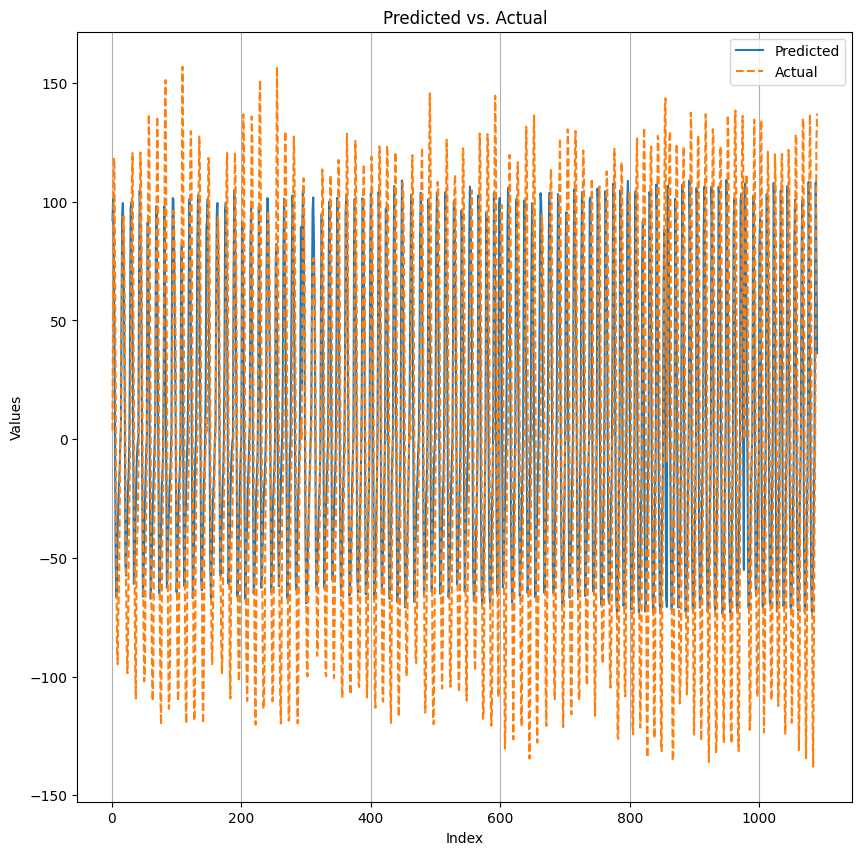

In [20]:
ResultadosRegressao(Resultados4Matrix[0],Resultados4Matrix[1],Resultados4Matrix[3])

# Exercicio 4 Cross Validation Repeticoes

SCENE 0  TRAIN: [3649 4003 1216 ... 4180 1180  621]  TEST: [   0    1    2 ... 4367 4368 4369]
min_v,max_v: -10.30337429 4.227209568 [[-2.29203379 -3.3314724  -1.40587658 ... -1.43102419 -0.62031007
  -0.08143067]
 [ 0.64785279  0.17004639  0.0359253  ...  0.65863037  0.48858401
  -1.21547246]
 [-1.03704345 -0.64186525 -0.66342044 ...  0.02275269  0.96998292
   0.29458743]
 ...
 [ 0.46223879  1.11128914  1.43461674 ...  0.07424561 -0.93405765
  -0.91130498]
 [-0.75682623 -1.28373051 -1.36995119 ... -0.71132082 -0.04790039
   1.11607909]
 [-1.34959358 -1.71483409 -2.05013681 ... -2.49321532 -2.79019785
  -2.83211076]]
normal [[0.55134333 0.47980879 0.61232899 ... 0.61059832 0.66639196 0.70347783]
 [0.75366738 0.72078457 0.71155431 ... 0.7544091  0.74270645 0.62543267]
 [0.63771222 0.66490852 0.66342509 ... 0.71064777 0.77583649 0.72935553]
 ...
 [0.74089336 0.78556124 0.80781276 ... 0.71419153 0.64479974 0.64636558]
 [0.65699687 0.62073512 0.61480139 ... 0.66012857 0.7057854  0.78589088

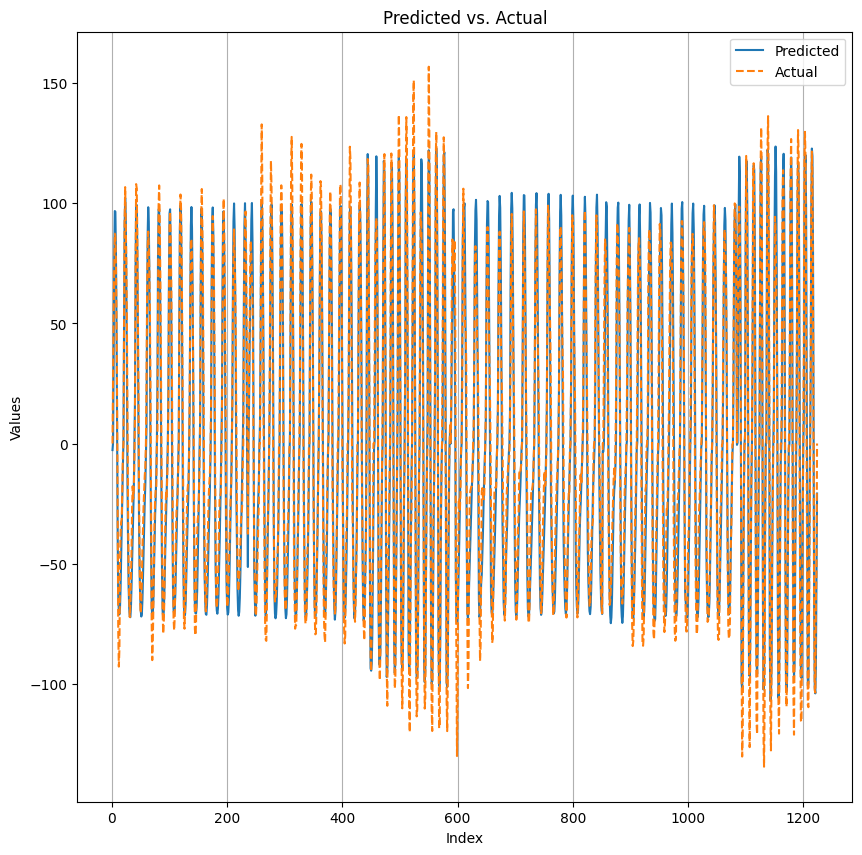

SCENE 1  TRAIN: [ 760 4525 4038 ... 1709 2638 1135]  TEST: [ 236  237  238 ... 4487 4488 4489]
min_v,max_v: -10.30337429 4.227209568 [[-2.86683845 -2.71834731 -2.58781868 ... -1.21666998 -2.99856448
  -2.37705696]
 [-0.62390259 -0.22273682  0.6203101  ...  0.11256592  0.07185059
   0.10298584]
 [ 0.17363892 -2.03097653 -0.99273565 ... -0.28740236 -0.74964117
  -0.36404298]
 ...
 [ 0.5137317  -0.33530274 -0.49696657 ... -1.01548827 -0.31494509
  -0.11735597]
 [-4.78764415 -1.49329478 -0.89453983 ... -3.17579603 -3.58773947
  -2.68242204]
 [-0.71611088 -0.15807129  1.40707403 ... -1.13284433 -1.97349614
  -1.84177005]]
normal [[0.51178507 0.52200428 0.53098731 ... 0.62535025 0.50271963 0.54549201]
 [0.66614472 0.69375309 0.75177188 ... 0.71682875 0.7140267  0.71616944]
 [0.72103181 0.56930938 0.64076149 ... 0.68930279 0.65749135 0.68402835]
 ...
 [0.74443712 0.68600626 0.6748805  ... 0.63919565 0.68740729 0.70100544]
 [0.37959453 0.60631284 0.64751937 ... 0.4905225  0.4621724  0.52447667

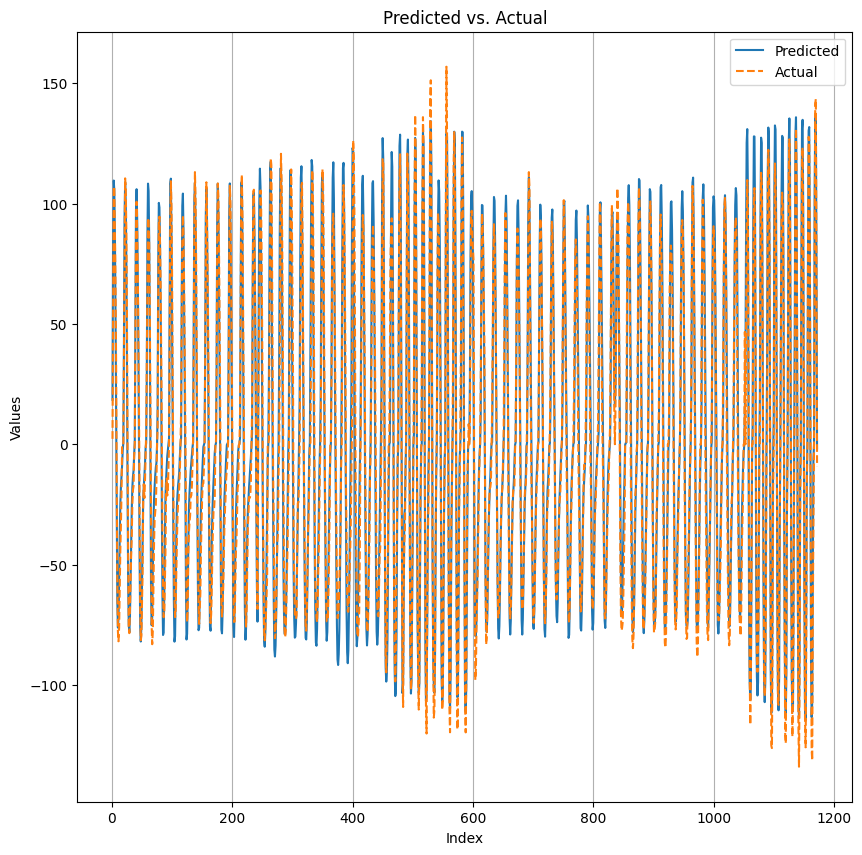

SCENE 2  TRAIN: [3426 4371 3749 ...  258 4028 4482]  TEST: [ 478  479  480 ... 4606 4607 4608]
min_v,max_v: -10.30337429 3.558999062 [[-0.366438   -1.45138192 -2.00942141 ... -1.5867005  -0.84065187
  -2.56746113]
 [ 0.49816409 -0.11376342 -0.23231691 ... -0.04430786 -0.1460962
   0.49097902]
 [-0.06706055  0.21555176 -0.49576907 ...  0.81191164 -0.05508545
  -0.49337405]
 ...
 [-0.96998292 -1.54718268 -2.05253172 ... -2.62015152 -2.46806765
  -2.11001229]
 [-1.13643679 -0.05269043 -0.45505372 ...  0.25387207  0.78556645
   1.32684088]
 [-3.29075694 -2.59380627 -2.99856448 ...  0.19279908  0.66581544
   1.70764899]]
normal [[0.71682792 0.63856254 0.59830685 ... 0.62880097 0.68261922 0.55805113]
 [0.77919835 0.73505529 0.72650311 ... 0.74006566 0.73272288 0.77868003]
 [0.73842433 0.75881134 0.70749827 ... 0.80183138 0.73928818 0.70767105]
 ...
 [0.67328957 0.63165169 0.59519697 ... 0.55425017 0.56522115 0.59105045]
 [0.66128197 0.73946096 0.71043539 ... 0.76157568 0.7999309  0.8389772 ]

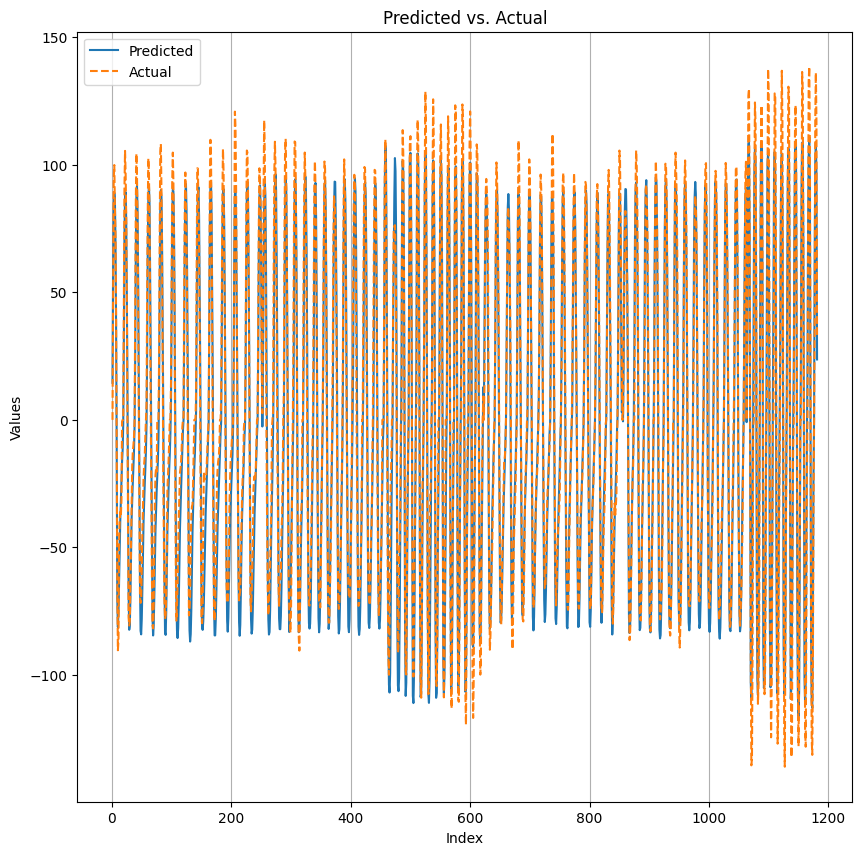

SCENE 3  TRAIN: [3474 3999 1906 ... 2545 1329 3104]  TEST: [ 729  730  731 ... 4719 4720 4721]
min_v,max_v: -9.122630119499998 4.227209568 [[-0.84065187 -2.56746113 -3.2428565  ... -0.5724097  -0.88855231
  -1.04183352]
 [-0.76401126  0.05029542  0.75083867 ... -1.46694952  0.5125342
  -0.66581544]
 [-4.13979137 -3.42008793 -6.12167025 ...  1.20349735  0.94962528
   0.1460962 ]
 ...
 [-2.42016733 -3.02730489 -3.59013438 ... -2.63452148 -2.21180058
  -3.83083379]
 [-2.61536145 -2.26688612 -1.0178833  ... -0.35206789 -0.61552006
  -2.30041635]
 [-1.81781995 -2.45729017 -1.92320073 ... -2.04414928 -2.5650661
  -2.87641859]]
normal [[0.62038035 0.49102979 0.44043777 ... 0.64047364 0.61679226 0.60531038]
 [0.62612129 0.68711878 0.73959456 ... 0.57346611 0.72174382 0.63347687]
 [0.37325083 0.42716185 0.2247937  ... 0.77350198 0.75448512 0.69429495]
 ...
 [0.50206317 0.45658415 0.41442413 ... 0.48600648 0.51767135 0.396394  ]
 [0.48744171 0.51354504 0.60710443 ... 0.65697884 0.63724436 0.5110

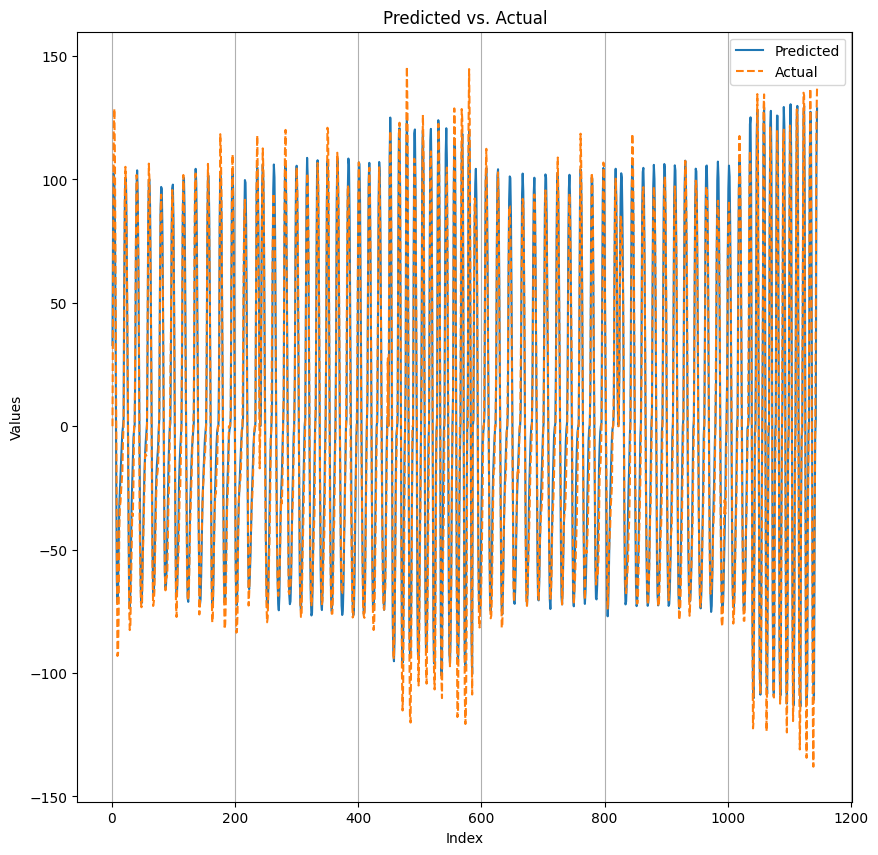

In [21]:
ResultadosRegressao(Resultados4Matrix[0],Resultados4Matrix[1],Resultados4Matrix[4])